<a href="https://colab.research.google.com/github/Noy-Bo/Cancer-Cell-Segmentation/blob/master/Cancer_Cell_Segmentation_UNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mounting Google Drive

mounting drive, setting root path to PanNuke dataset, setting device to cuda, checking out GPU


In [ ]:

from google.colab import drive
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [ ]:
import os
root_path = '/content/gdrive/MyDrive/PanNuke/' 
os.chdir(root_path)


In [ ]:
import torch
device = torch.device('cpu')
if torch.cuda.is_available():
    device = torch.device('cuda')
print(device)

cuda


In [ ]:
!nvidia-smi

Sat Jul 31 10:26:25 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P0    28W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **Dataset**
loading files, creating dataloaders, etc..



In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import random
from torch.utils.data import Dataset
import torch
from torch.utils.data import DataLoader, SubsetRandomSampler
from torchvision.transforms import transforms
import torch
from torch.utils.data import Dataset
import numpy as np
import pickle


class PanNukeDataset(Dataset):
    def __init__(self, image_dir, masks_dir=None, cancer_types_dir=None, transform=None, augment=False):
        #self.image_dir = image_dir
        #self.masks_dir = masks_dir
        #self.cancer_types_dir = cancer_types_dir
        self.transform = transform

        # Data is pickled into dictionaries ({'images': imgs, 'cancer_types': cancer_types, 'masks':masks}), let's open it up:
        with open(image_dir, mode='rb') as f:  # The with just manages closing of files and etc once finished.
            data_dict = pickle.load(f)  # load the original pickled dataset

        self.images = data_dict['images']
        self.cancer_types = data_dict['cancer_types']
        self.masks = data_dict['masks']



    def __len__(self):
        return self.images.shape[0]

    # # returns images,masks   FOR NOW IT DOESN'T RETURN cancer_types!!!
    # def __getitem__(self, index):
    #     image = self.images[index, ...].astype(dtype=np.float32)
    #     mask = self.masks[index, ...].astype(dtype=np.float32)
    #     mask[mask > 0] = 1.0

    #     # AUGMENTATION
    #     if self.transform is True:
    #         image = transforms.ToTensor()(image)
    #         mask = transforms.ToTensor()(mask)

    #         # ROTATION
    #         if random.random() >= 0.5:
    #             times = 1
    #             rnd = random.random()
    #             if  0.66 > rnd > 0.33:
    #                 times = 2
    #             elif rnd > 0.66:
    #                 times = 3
    #             image = torch.rot90(image,times,(1,2))
    #             mask = torch.rot90(mask,times,(1,2))

    #         # FLIP
    #         if random.random() >= 0.5:
    #             trans = transforms.RandomVerticalFlip(1)
    #             if random.random() >= 0.5:
    #                 trans = transforms.RandomHorizontalFlip(1)
    #             image = trans(image)
    #             mask = trans(mask)

    #         image = image.numpy()
    #         mask = mask.numpy()

    #     else:
    #         mask = np.moveaxis(mask, -1, 0)
    #         image = np.moveaxis(image, -1, 0)

    #     return torch.from_numpy(image),torch.from_numpy(mask)

    # with normalization
    def __getitem__(self, index):
        image = self.images[index, ...].astype(dtype=np.float32)
        mask = self.masks[index, ...].astype(dtype=np.float32)
        mask[mask > 0] = 1.0

        image = transforms.ToTensor()(image)
        mask = transforms.ToTensor()(mask)
        image = image / 255
        image = transforms.Normalize(mean=[0.74636905, 0.58091097, 0.7092674 ], std=[0.18765187, 0.22254046, 0.17476417])(image)
        
        # AUGMENTATION
        if self.transform:

            # ROTATION
            if random.random() >= 0.5:
                times = 1
                rnd = random.random()
                if  0.66 > rnd > 0.33:
                    times = 2
                elif rnd > 0.66:
                    times = 3
                image = torch.rot90(image,times,(1,2))
                mask = torch.rot90(mask,times,(1,2))

            # FLIP
            if random.random() >= 0.5:
                trans = transforms.RandomVerticalFlip(1)
                if random.random() >= 0.5:
                    trans = transforms.RandomHorizontalFlip(1)
                image = trans(image)
                mask = trans(mask)

        return image,mask
# Creating dataloaders
def load_dataset(batch_size, shuffle_flag, num_workers, data_dir, transform=None):
  dataset = PanNukeDataset(data_dir, transform=transform)
  data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle_flag, num_workers=num_workers)
  return data_loader

# **Model**
basic UNet model configuration

In [ ]:
from collections import OrderedDict

import torch
import torch.nn as nn


def double_conv(in_channels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),
        nn.ReLU(inplace=True),
        nn.Conv2d(out_channels, out_channels, 3, padding=1),
        nn.ReLU(inplace=True)
    )


class Unet(nn.Module): # 0.244 on vallidation
    def __init__(self, scale=1):
        super().__init__()
        self.dblock1 = double_conv(3, 128*scale)
        self.dblock2 = double_conv(128*scale, 256*scale)
        self.dblock3 = double_conv(256*scale, 512*scale)
        self.dblock4 = double_conv(512*scale, 1024*scale)

        self.dropout = nn.Dropout2d()
        self.pool = nn.MaxPool2d(2)
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

        self.dblock5 = double_conv(512*scale + 1024*scale, 512*scale)
        self.dblock6 = double_conv(256*scale + 512*scale, 256*scale)
        self.dblock7 = double_conv(256*scale + 128*scale, 128*scale)
        self.relu = nn.ReLU()
        self.last_layer = nn.Conv2d(128*scale, 6, 1)
        #self.last_layer_rly = nn.Conv2d(512,6,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        conv1 = self.dblock1(x)
        x = self.pool(conv1)

        conv2 = self.dblock2(x)
        x = self.pool(conv2)

        conv3 = self.dblock3(x)
        x = self.pool(conv3)
        x = self.dropout(x) # dropout
        
        conv4 = self.dblock4(x)
        conv4 = self.dropout(conv4) # dropout
        x = self.upsample(conv4)

        x = torch.cat([x, conv3], dim=1)

        

        x = self.dblock5(x)
        x = self.upsample(x)
        x = torch.cat([x, conv2], dim=1)

        x = self.dblock6(x)
        x = self.upsample(x)
        x = torch.cat([x, conv1], dim=1)

        x = self.dblock7(x)

        out = self.last_layer(x)
        #out = self.last_layer_rly(x)
        # out = self.sigmoid(x)
        return out


# class UNet(nn.Module):

#     def __init__(self, in_channels=3, out_channels=1, init_features=128):
#         super(UNet, self).__init__()

#         features = init_features
#         self.dropout = nn.Dropout2d()
#         self.encoder1 = UNet._block(in_channels, features, name="enc1")
#         self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder2 = UNet._block(features, features * 2, name="enc2")
#         self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
#         self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
#         self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

#         self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

#         self.upconv4 = nn.ConvTranspose2d(
#             features * 16, features * 8, kernel_size=2, stride=2
#         )
#         self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
#         self.upconv3 = nn.ConvTranspose2d(
#             features * 8, features * 4, kernel_size=2, stride=2
#         )
#         self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
#         self.upconv2 = nn.ConvTranspose2d(
#             features * 4, features * 2, kernel_size=2, stride=2
#         )
#         self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
#         self.upconv1 = nn.ConvTranspose2d(
#             features * 2, features, kernel_size=2, stride=2
#         )
#         self.decoder1 = UNet._block(features * 2, features, name="dec1")

#         self.conv_masks = nn.Conv2d(in_channels=features, out_channels=6, kernel_size=1)

#         # self.conv = nn.Conv2d(
#         #     in_channels=features, out_channels=out_channels, kernel_size=1
#         # )


#     def forward(self, x):
#         x = x.to(device)
#         enc1 = self.encoder1(x)
#         enc2 = self.encoder2(self.pool1(enc1))
#         enc3 = self.encoder3(self.pool2(enc2))
#         enc3 = self.dropout(enc3)
#         enc4 = self.encoder4(self.pool3(enc3))
#         enc4 = self.dropout(enc4)

#         bottleneck = self.bottleneck(self.pool4(enc4))
#         bottleneck = self.dropout(bottleneck)

#         dec4 = self.upconv4(bottleneck)
#         dec4 = torch.cat((dec4, enc4), dim=1)
#         dec4 = self.decoder4(dec4)
#         dec3 = self.upconv3(dec4)
#         dec3 = torch.cat((dec3, enc3), dim=1)
#         dec3 = self.decoder3(dec3)
#         dec2 = self.upconv2(dec3)
#         dec2 = torch.cat((dec2, enc2), dim=1)
#         dec2 = self.decoder2(dec2)
#         dec1 = self.upconv1(dec2)
#         dec1 = torch.cat((dec1, enc1), dim=1)
#         dec1 = self.decoder1(dec1)
#         #return torch.sigmoid(self.conv(dec1))
#         return torch.sigmoid(self.conv_masks(dec1))

#     #@staticmethod
#     def _block(in_channels, features, name):
#         return nn.Sequential(
#             OrderedDict(
#                 [
#                     (
#                         name + "conv1",
#                         nn.Conv2d(
#                             in_channels=in_channels,
#                             out_channels=features,
#                             kernel_size=3,
#                             padding=1,
#                             bias=False,
#                         ),
#                     ),
#                     (name + "norm1", nn.BatchNorm2d(num_features=features)),
#                     (name + "relu1", nn.ReLU(inplace=True)),
#                     (
#                         name + "conv2",
#                         nn.Conv2d(
#                             in_channels=features,
#                             out_channels=features,
#                             kernel_size=3,
#                             padding=1,
#                             bias=False,
#                         ),
#                     ),
#                     (name + "norm2", nn.BatchNorm2d(num_features=features)),
#                     (name + "relu2", nn.ReLU(inplace=True)),
#                 ]
#             )
#         )

# **Metrics**
evaluation metrics

In [ ]:
import torch

def calc_PQ(outputs: torch.Tensor, labels: torch.Tensor):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape

    # TP == INTERSECTION = PRED==1 GT==1
    # FP = PRED==1 GT ==0
    # FN = PRED==0 GT==1
    # TN = PRED==0, Gt==0

    outputs = outputs.int()
    labels = labels.int()
    PQ = []
    DICE = []
    IOU = []
    confusion_vector = outputs / labels
    for batch in range(outputs.shape[0]):
        for mask in range(outputs.shape[1]):
            TP = torch.sum(confusion_vector[batch,mask,...] == 1).item()
            FP = torch.sum(confusion_vector[batch,mask,...]  == float('inf')).item()
            TN = torch.sum(torch.isnan(confusion_vector[batch,mask,...])).item()
            FN = torch.sum(confusion_vector[batch,mask,...]  == 0).item()
            if FN != 0 or FP != 0 or TP != 0:
              #print("TP: {},  FP: {},  FN: {}".format(str(TP),str(FP),str(FN)) )
              IOU.append((TP ) / (TP + FP + FN))
              #PQ.append(((IOU ) / ((TP + 0.5 * FP + 0.5 * FN) )))
              DICE.append((2*TP) / (2*TP + FP + FN))

    return (sum(DICE)/len(DICE)), (sum(IOU)/len(IOU))


# **Data Utilities**
visualizations, mean/var extraction

In [ ]:
import cv2
# calc normalization values of given data loader
def calc_normalization(data_loader):
    pop_mean = []
    pop_std0 = []
    pop_std1 = []
    for idx_batch, (images, masks) in enumerate(data_loader, 0):
     # shape (batch_size, 3, height, width)
     numpy_image = images.numpy()

     # shape (3,)
     batch_mean = np.mean(numpy_image, axis=(0, 2, 3))
     batch_std0 = np.std(numpy_image, axis=(0, 2, 3))
     batch_std1 = np.std(numpy_image, axis=(0, 2, 3), ddof=1)

     pop_mean.append(batch_mean/255)
     pop_std0.append(batch_std0/255)
     pop_std1.append(batch_std1/255)

    # shape (num_iterations, 3) -> (mean across 0th axis) -> shape (3,)
    pop_mean = np.array(pop_mean).mean(axis=0)
    print(pop_mean)
    pop_std0 = np.array(pop_std0).mean(axis=0)
    print(pop_std0)
    pop_std1 = np.array(pop_std1).mean(axis=0)
    print(pop_std1)


# VISUALIZING SAMPLES - designed for input that is the dataloader output, for raw input cancel moveaxis
def vis_sample(image, masks):
    fig, axs = plt.subplots(1,7)
    fig.set_size_inches(18.5, 3.2)
    fig.suptitle('Ground Truth', fontsize=18)
    #fig.tight_layout()
    axs[0].imshow(np.moveaxis(image.cpu().detach().numpy().astype(np.uint8),0,-1)); axs[0].set_title("Sample")
    masks = np.moveaxis(masks.cpu().detach().numpy().astype(np.uint8),0,-1)
    axs[1].imshow(masks[:,:,0], cmap="gray"); axs[1].set_title("Neoplastic cells")
    axs[2].imshow(masks[:,:,1], cmap="gray"); axs[2].set_title("Inflammatory")
    axs[3].imshow(masks[:,:,2], cmap="gray"); axs[3].set_title("Connective/Soft tissue cells")
    axs[4].imshow(masks[:,:,3], cmap="gray"); axs[4].set_title("Dead Cells")
    axs[5].imshow(masks[:,:,4], cmap="gray"); axs[5].set_title("Epithelial")
    axs[6].imshow(masks[:,:,5], cmap="gray"); axs[6].set_title("Background")
    plt.show()

# VISUALIZING PREDICTIONS - visualizing network output on a random sample.
def vis_predictions():
    image_gt_batch, masks_gt_batch = iter(validation_loader).next()
    image_gt_batch = image_gt_batch.to(device)
    masks_gt_batch = masks_gt_batch.to(device)
    pred_masks_batch = model(image_gt_batch)
      
    for i in range(image_gt_batch.shape[0]): # looping on batch_size
      print("\n\n")
      print("\t\t\t\t\t\t\t\t SAMPLE: {}".format(str(i)))
      image = image_gt_batch[i,...] # 3,256,256
      pred_masks = pred_masks_batch[i,...] # 6,256,256
      one_hot_masks = torch.nn.functional.one_hot(torch.argmax(pred_masks, dim=0))
      one_hot_masks = one_hot_masks.permute(2,0,1)
      one_hot_masks *= 250 # white color?
      fig, axs = plt.subplots(1,7)
      fig.set_size_inches(18.5, 3.3)
      fig.suptitle('Prediction', fontsize=18)
      #fig.tight_layout()
      axs[0].imshow(np.moveaxis(image.cpu().detach().numpy().astype(np.uint8),0,-1)); axs[0].set_title("Sample")
      axs[1].imshow(one_hot_masks[0,:,:].cpu().detach().numpy(), cmap="gray"); axs[1].set_title("Neoplastic cells")
      axs[2].imshow(one_hot_masks[1,:,:].cpu().detach().numpy(), cmap="gray"); axs[2].set_title("Inflammatory")
      axs[3].imshow(one_hot_masks[2,:,:].cpu().detach().numpy(), cmap="gray"); axs[3].set_title("Connective/Soft tissue cells")
      axs[4].imshow(one_hot_masks[3,:,:].cpu().detach().numpy(), cmap="gray"); axs[4].set_title("Dead Cells")
      axs[5].imshow(one_hot_masks[4,:,:].cpu().detach().numpy(), cmap="gray"); axs[5].set_title("Epithelial")
      axs[6].imshow(one_hot_masks[5,:,:].cpu().detach().numpy(), cmap="gray"); axs[6].set_title("Background")
      plt.show()

      vis_sample(image,masks_gt_batch[i,...]) # visualizing gt (ground truth)
  
  
# Visualizes a random batch from a given data-loader
def visualize_segmented_ground_truth(data_loader, model, model_type): #model type = micronet = micrionet / unet = other
    # Colors according to the PanNuke-dataset paper:
    colors = {"1neoplastic":(255,0,0), "2inflammatory":(0,255,0), "3connective":(0,0,255), "4dead":(255,255,0), "5epithelial":(255,102,0)}
    model.eval()

    # Grab model predictions of a random batch:
    images_gt_batch, masks_gt_batch = iter(data_loader).next()
    images_gt_batch = images_gt_batch.to(device)
    # REVERT NORMALIZATION
    images_gt_batch[:,0,...] *= 0.18765187
    images_gt_batch[:,1,...] *= 0.22254046
    images_gt_batch[:,2,...] *= 0.17476417
    images_gt_batch[:,0,...] += 0.74636905
    images_gt_batch[:,1,...] += 0.58091097
    images_gt_batch[:,2,...] += 0.7092674
    images_gt_batch *= 255

    if model_type == "micronet":
        masks_pred_batch, _, _, _ = model(images_gt_batch)  # Grabbing only PO predictions.
    else:
        masks_pred_batch = model(images_gt_batch)

    #mask_pred_batch = mask_pred_batch.cpu() # adjusting to colab
    # Turn masks maps to edges maps:
    pred_masks_edges = np.zeros((masks_gt_batch.shape))
    gt_masks_edges = np.zeros((masks_gt_batch.shape))

    for i in range(images_gt_batch.shape[0]): # looping on batch_size
        # Grab the i'th prediction masks (which hold scores) and adjust it to final prediction (one hots...)
        ith_pred = masks_pred_batch[i, ...] # CH,H,W
        ith_onehot_pred_masks = torch.nn.functional.one_hot(torch.argmax(ith_pred, dim=0)) # returns HxWxCH
        ith_onehot_pred_masks = ith_onehot_pred_masks.permute(2, 0, 1) # sets dimensions so that for example, dim=2 will be now dim=0, hence will get CH,H,W

        # Grab the i'th gt masks (already onehots)
        ith_onehot_gt_masks = masks_gt_batch[i, ...]

        # Adjust pixels' values:
        ith_onehot_pred_masks[ith_onehot_pred_masks > 0] = 255
        ith_onehot_gt_masks[ith_onehot_gt_masks > 0] = 255

        # Turn prediction masks to edges maps:
        ith_onehot_pred_masks = ith_onehot_pred_masks.cpu().numpy().astype(dtype=np.uint8)
        for j in range(ith_onehot_pred_masks.shape[0]):
            edges = cv2.Canny(ith_onehot_pred_masks[j, ...], 1, 4)   # CHECK Canny's parameters...  CAN BE IMPROVED
            pred_masks_edges[i, j, ...] = edges

        # Turn gt masks to edges maps:
        ith_onehot_gt_masks = ith_onehot_gt_masks.cpu().numpy().astype(dtype=np.uint8)
        for j in range(ith_onehot_gt_masks.shape[0]):
            edges = cv2.Canny(ith_onehot_gt_masks[j, ...], 1, 4)  # CHECK Canny's parameters...  CAN BE IMPROVED
            gt_masks_edges[i, j, ...] = edges


    # Given edges-masks-maps, paint every image in batch, according to gt_edges_masks & pred_edges_masks:
    segmented_gt_images = np.copy(images_gt_batch.cpu()) # B,CH,H,W
    segmented_pred_images = np.copy(images_gt_batch.cpu())

    # For every image in batch:
    for i in range(images_gt_batch.shape[0]):
        # For every edged-mask:
        for j, color in zip(range(gt_masks_edges.shape[0]-1), colors.keys()): #-1 since we don't paint using the "Backround mask"
            # Paint gt & pred images:
            segmented_gt_images[i, :, gt_masks_edges[i, j, ...] > 0] = colors[color]
            segmented_pred_images[i, :, pred_masks_edges[i, j, ...] > 0] = colors[color]

    # Adjust segmented images dimensions for imshow() operations:
    segmented_gt_images = np.transpose(segmented_gt_images, (0,2,3,1)) # from B,CH,H,W to B,H,W,CH (np.transpose is np version of torch.permute)
    segmented_pred_images = np.transpose(segmented_pred_images, (0,2,3,1))

    # Visualize GT vs PRED:
    fig, axarr = plt.subplots(2, segmented_gt_images.shape[0], figsize=(20, 9))
    fig.suptitle('First row= Ground Truth, Second row= Prediction', fontsize=14)
    fig.tight_layout()
    for i in range(segmented_gt_images.shape[0]):
        gt_img = segmented_gt_images[i, ...].astype(dtype=np.uint8)
        pred_img = segmented_pred_images[i, ...].astype(dtype=np.uint8)

        axarr[0, i].axis('off')
        axarr[0, i].imshow(gt_img)
        axarr[1, i].imshow(pred_img)
        axarr[1, i].axis('off')

    plt.show()

# **Train Utilities**
loss functions configurations, train epoch function ..


In [ ]:
import sys
import torch.nn as nn
import torch
import tqdm

device = torch.device('cpu')
if torch.cuda.is_available():
    device = torch.device('cuda')
print(device)

def CE_and_DICE(predict,target):
    loss = 0
    loss += CE(predict,target)
    loss += dice_loss(predict, target)
    return loss


def CE(predict, target):
    cross_entropy = nn.CrossEntropyLoss()
    softmax = torch.nn.Softmax(dim=1)
    assert predict.shape[0] == target.shape[0], "predict & target batch size don't match"
    loss = 0
    target =  torch.argmax(target, dim=1)
    loss += cross_entropy(predict,target)
    return loss

# Can be used for multiclass...
def dice_loss(logits, true, eps=1e-7):
    """Computes the Sørensen–Dice loss.
    Note that PyTorch optimizers minimize a loss. In this
    case, we would like to maximize the dice loss so we
    return the negated dice loss ( hence the 1 - dice_score ).
    Args:
        true: a tensor of shape [B, 1, H, W].
        logits: a tensor of shape [B, C, H, W]. Corresponds to
            the raw output or logits of the model.
        eps: added to the denominator for numerical stability.
    Returns:
        dice_loss: the Sørensen–Dice loss.
    """
    true = torch.argmax(true, dim=1)
    num_classes = logits.shape[1]
    if num_classes == 1:
        true_1_hot = torch.eye(num_classes + 1)[true.squeeze(1)]
        true_1_hot = true_1_hot.permute(0, 3, 1, 2).float()
        true_1_hot_f = true_1_hot[:, 0:1, :, :]
        true_1_hot_s = true_1_hot[:, 1:2, :, :]
        true_1_hot = torch.cat([true_1_hot_s, true_1_hot_f], dim=1)
        pos_prob = torch.sigmoid(logits)
        neg_prob = 1 - pos_prob
        probas = torch.cat([pos_prob, neg_prob], dim=1)
    else:
        true_1_hot = torch.eye(num_classes)[true.squeeze(1)]
        true_1_hot = true_1_hot.permute(0, 3, 1, 2).float()
        probas = nn.functional.softmax(logits, dim=1)
    true_1_hot = true_1_hot.type(logits.type())
    dims = (0,) + tuple(range(2, true.ndimension()))
    intersection = torch.sum(probas * true_1_hot, dims)
    cardinality = torch.sum(probas + true_1_hot, dims)
    dice_loss = (2. * intersection / (cardinality + eps)).mean()
    return (1 - dice_loss)


def train_epoch(training_loader, model, optimizer, loss_function, overfit=False, images=None, masks=None,vis=False):

    losses = []
    model.train()
    with tqdm.tqdm(total=len(training_loader), file=sys.stdout) as pbar:
        for (images, masks) in training_loader:

            images = images.to(device)
            masks = masks.to(device)

            # calculate output
            y_hat = model(images)

            # calculate loss now:
            optimizer.zero_grad()
            loss = loss_function(y_hat, masks)
            loss.backward()

            # optimizing weights
            optimizer.step()

            # update loss bar
            losses.append(loss.detach())
            pbar.update();
            pbar.set_description(f'train loss={losses[-1]:.3f}')
        mean_loss = torch.mean(torch.FloatTensor(losses))
        pbar.set_description(f'train loss={mean_loss:.3f}')

        images = None
        masks = None
    return [mean_loss]

    
def eval_loss_epoch(training_loader, model, loss_function):

    losses = []
    model.eval()
    with tqdm.tqdm(total=len(training_loader), file=sys.stdout) as pbar:
        for idx_batch, (images, masks) in enumerate(training_loader, start=1):

            images = images.to(device)
            masks = masks.to(device)

            # calculate output
            y_hat = model(images)

           

            # calculate loss now:
            loss = loss_function(y_hat, masks)

            # update loss bar
            losses.append(loss.detach())
            pbar.update();
            pbar.set_description(f'val loss={losses[-1]:.3f}')

            images = None
            masks = None
        mean_loss = torch.mean(torch.FloatTensor(losses))
        pbar.set_description(f'val loss={mean_loss:.3f}')

    return mean_loss


def eval_model(model,data_loader):
    DICE = []
    IOU = []
    model.eval()
    with tqdm.tqdm(total=len(data_loader), file=sys.stdout) as pbar:
        for (images, masks) in data_loader:
            images = images.to(device)
            masks = masks.to(device)

            # calculate output
            y_hat = model(images)
            y_hat = y_hat.to(device)

            # generate one hot vectors
            one_hot_masks = torch.nn.functional.one_hot(torch.argmax(y_hat, dim=1))
            one_hot_masks = one_hot_masks.permute(0, 3, 1, 2)
            one_hot_masks = one_hot_masks.to(device)

            dice_score, iou_score = calc_PQ(outputs=one_hot_masks, labels=masks)
            DICE.append(dice_score)
            IOU.append(iou_score)

            pbar.update();
            pbar.set_description(f'IOU ={IOU[-1]:.3f} ; DICE ={DICE[-1]:.3f}')
        mean_dice = torch.mean(torch.FloatTensor(DICE))
        mean_iou = torch.mean(torch.FloatTensor(IOU))
        pbar.set_description(f'IOU ={mean_iou:.3f} ; DICE ={mean_dice:.3f}')

    return

def train_on_1_batch(model, optimizer, loss_function, images, masks,vis=False):
    losses = []
    model.train()
    images = images.to(device)
    masks = masks.to(device)
    pred_masks_batch = model(images)
    for i in range(images.shape[0]): # looping on batch_size
      image = images[i,...] # 3,256,256
      pred_masks = pred_masks_batch[i,...]
      one_hot_masks = torch.nn.functional.one_hot(torch.argmax(pred_masks, dim=0))
      one_hot_masks = one_hot_masks.permute(2,0,1)
      one_hot_masks *= 250 # white color?

      if vis is True:
        print("\n\n")
        print("\t\t\t\t\t\t\t\t SAMPLE: {}".format(str(i)))
        fig, axs = plt.subplots(1,7)
        fig.set_size_inches(18.5, 3.3)
        fig.suptitle('Prediction', fontsize=18)
        #fig.tight_layout()
        axs[0].imshow(np.moveaxis(image.cpu().detach().numpy().astype(np.uint8),0,-1)); axs[0].set_title("Sample")
        axs[1].imshow(one_hot_masks[0,:,:].cpu().detach().numpy(), cmap="gray"); axs[1].set_title("Neoplastic cells")
        axs[2].imshow(one_hot_masks[1,:,:].cpu().detach().numpy(), cmap="gray"); axs[2].set_title("Inflammatory")
        axs[3].imshow(one_hot_masks[2,:,:].cpu().detach().numpy(), cmap="gray"); axs[3].set_title("Connective/Soft tissue cells")
        axs[4].imshow(one_hot_masks[3,:,:].cpu().detach().numpy(), cmap="gray"); axs[4].set_title("Dead Cells")
        axs[5].imshow(one_hot_masks[4,:,:].cpu().detach().numpy(), cmap="gray"); axs[5].set_title("Epithelial")
        axs[6].imshow(one_hot_masks[5,:,:].cpu().detach().numpy(), cmap="gray"); axs[6].set_title("Background")
        plt.show()

        vis_sample(image,masks[i,...]) # visualizing gt (ground truth)
    #calculate output
    y_hat = model(images)

    # calculate loss now:
    optimizer.zero_grad()
    loss = loss_function(y_hat, masks)
    loss.backward()

    # optimizing weights
    optimizer.step()

    # update loss bar
    losses.append(loss.detach())
    mean_loss = torch.mean(torch.FloatTensor(losses))
    return mean_loss


cuda


# **Creating Data Loaders**

In [ ]:
train_dir = '/content/gdrive/MyDrive/PanNuke/train_pickled_data'
val_dir = '/content/gdrive/MyDrive/PanNuke/val_pickled_data'
test_dir = '/content/gdrive/MyDrive/PanNuke/test_pickled_data'
# Grab loaders:
#load_dataset(2,None,None,None)
validation_loader = load_dataset(batch_size=12, shuffle_flag=True, num_workers=4, data_dir=val_dir)
test_loader = load_dataset(batch_size=12, shuffle_flag=True, num_workers=4, data_dir=test_dir)
training_loader = load_dataset(batch_size=12, shuffle_flag=True, num_workers=4, data_dir=train_dir, transform=True)


# **Main (training)**


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1        [-1, 128, 256, 256]           3,584
              ReLU-2        [-1, 128, 256, 256]               0
            Conv2d-3        [-1, 128, 256, 256]         147,584
              ReLU-4        [-1, 128, 256, 256]               0
         MaxPool2d-5        [-1, 128, 128, 128]               0
            Conv2d-6        [-1, 256, 128, 128]         295,168
              ReLU-7        [-1, 256, 128, 128]               0
            Conv2d-8        [-1, 256, 128, 128]         590,080
              ReLU-9        [-1, 256, 128, 128]               0
        MaxPool2d-10          [-1, 256, 64, 64]               0
           Conv2d-11          [-1, 512, 64, 64]       1,180,160
             ReLU-12          [-1, 512, 64, 64]               0
           Conv2d-13          [-1, 512, 64, 64]       2,359,808
             ReLU-14          [-1, 512,

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


train loss=0.544: 100%|██████████| 527/527 [07:06<00:00,  1.24it/s]
VAL LOSS:
val loss=0.604: 100%|██████████| 66/66 [00:21<00:00,  3.05it/s]


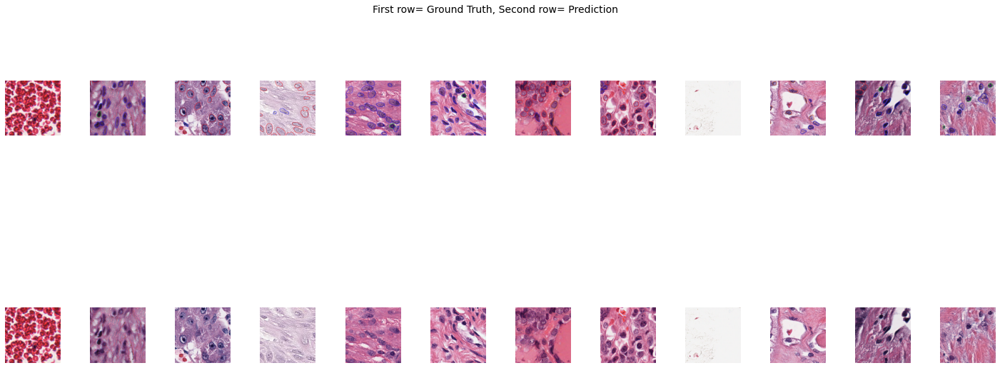

=========================== EPOCH: 2 ===========================
TRAIN LOSS:
train loss=0.450: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.562: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


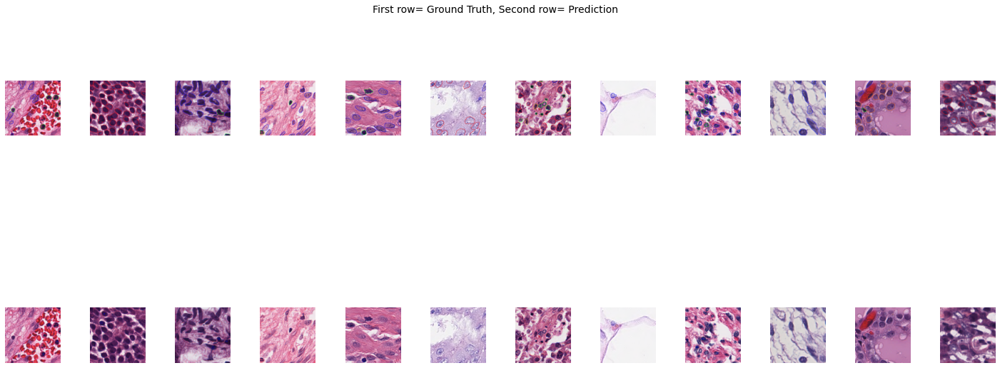

=========================== EPOCH: 3 ===========================
TRAIN LOSS:
train loss=0.416: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.494: 100%|██████████| 66/66 [00:21<00:00,  3.05it/s]


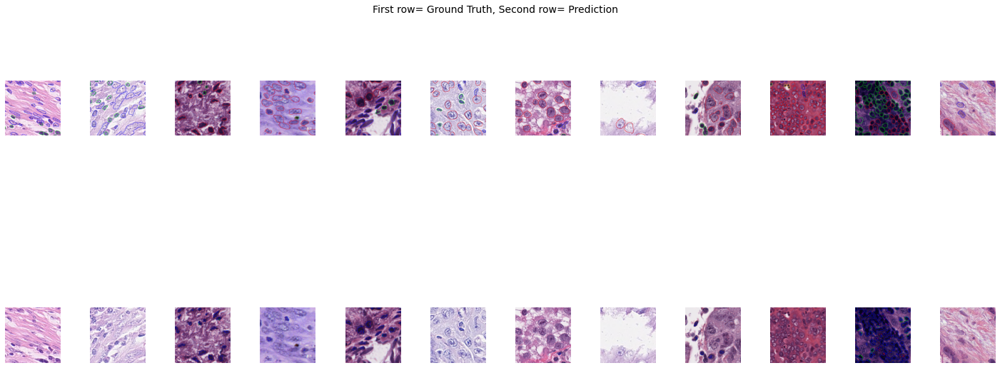

=========================== EPOCH: 4 ===========================
TRAIN LOSS:
train loss=0.382: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.516: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


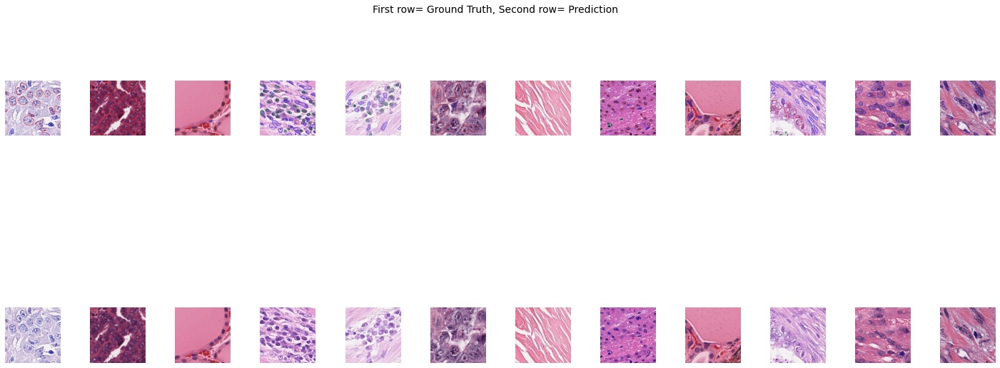

=========================== EPOCH: 5 ===========================
TRAIN LOSS:
train loss=0.344: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.374: 100%|██████████| 66/66 [00:21<00:00,  3.04it/s]


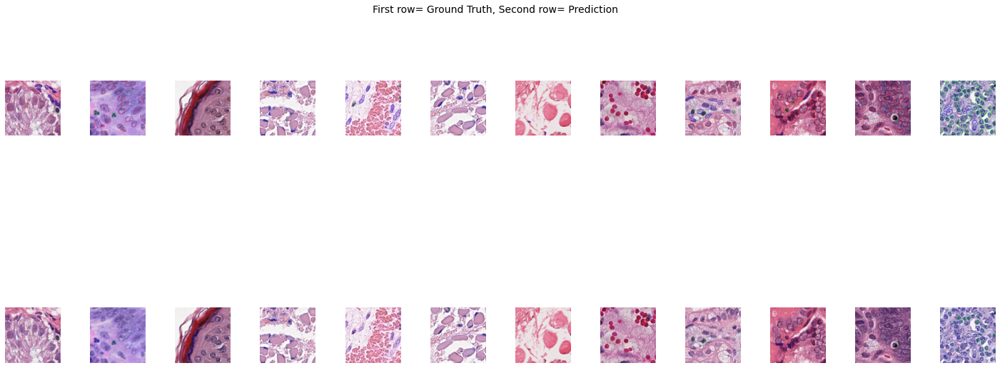

=========================== EPOCH: 6 ===========================
TRAIN LOSS:
train loss=0.320: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.369: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


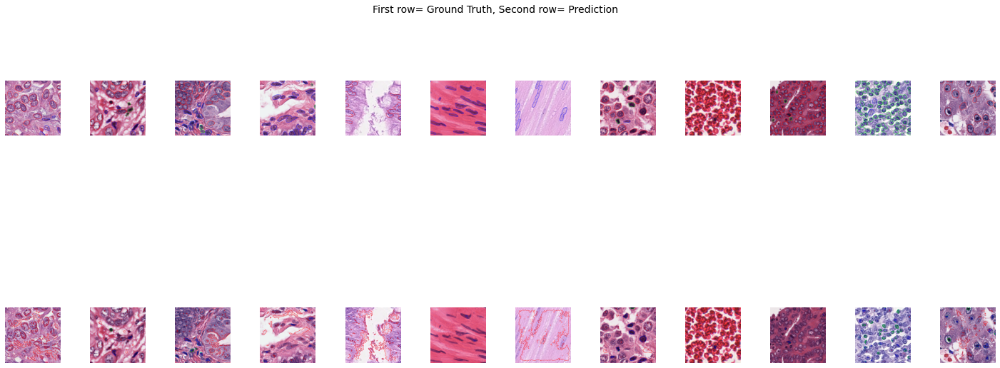

=========================== EPOCH: 7 ===========================
TRAIN LOSS:
train loss=0.305: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.329: 100%|██████████| 66/66 [00:21<00:00,  3.04it/s]


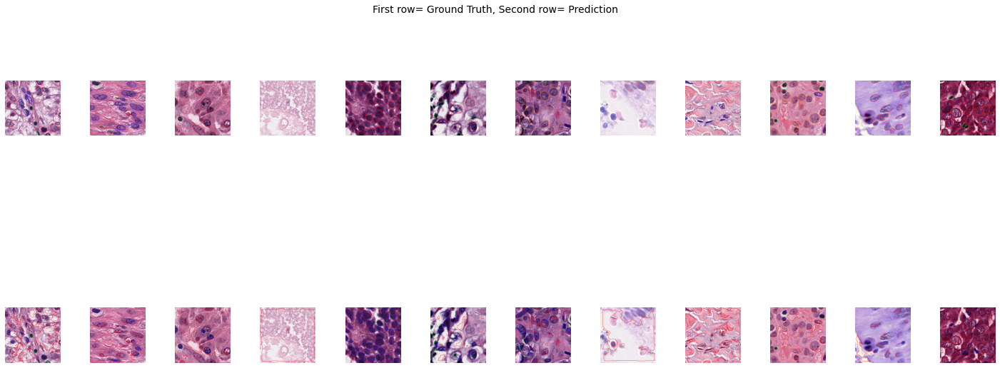

=========================== EPOCH: 8 ===========================
TRAIN LOSS:
train loss=0.300: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.390: 100%|██████████| 66/66 [00:21<00:00,  3.04it/s]


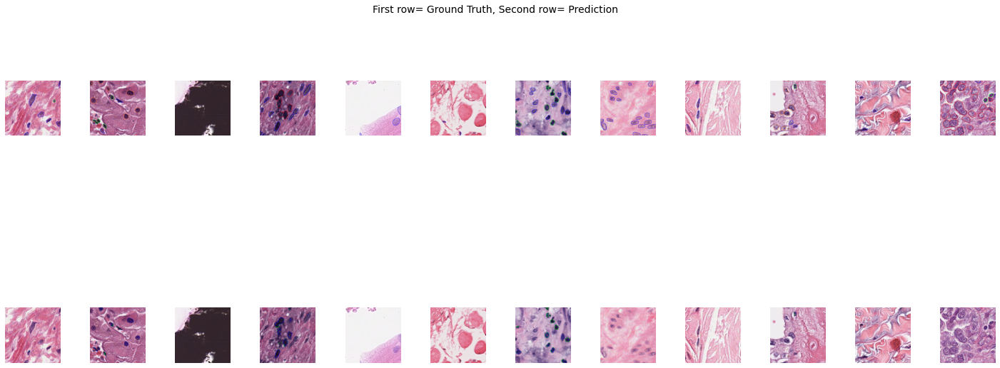

=========================== EPOCH: 9 ===========================
TRAIN LOSS:
train loss=0.297: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.312: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


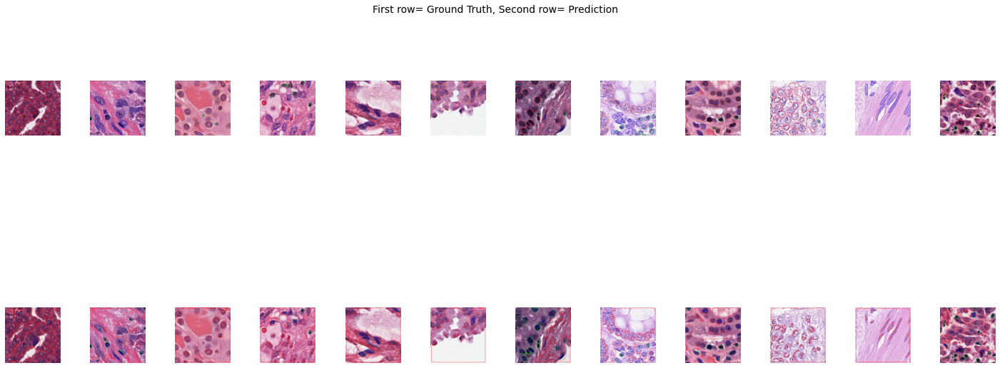

=========================== EPOCH: 10 ===========================
TRAIN LOSS:
train loss=0.281: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.310: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


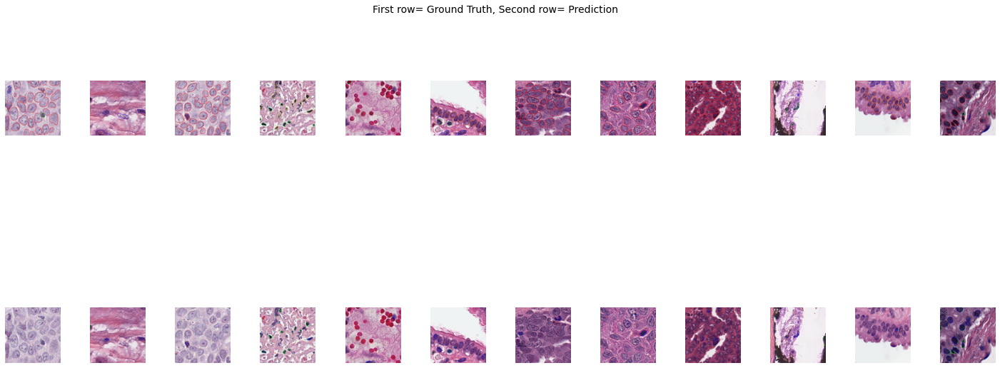

=========================== EPOCH: 11 ===========================
TRAIN LOSS:
train loss=0.274: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.297: 100%|██████████| 66/66 [00:21<00:00,  3.04it/s]


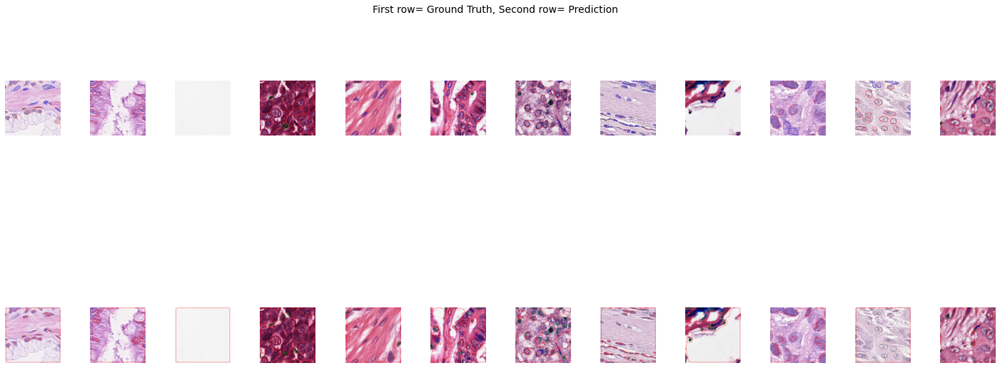

=========================== EPOCH: 12 ===========================
TRAIN LOSS:
train loss=0.269: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.306: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


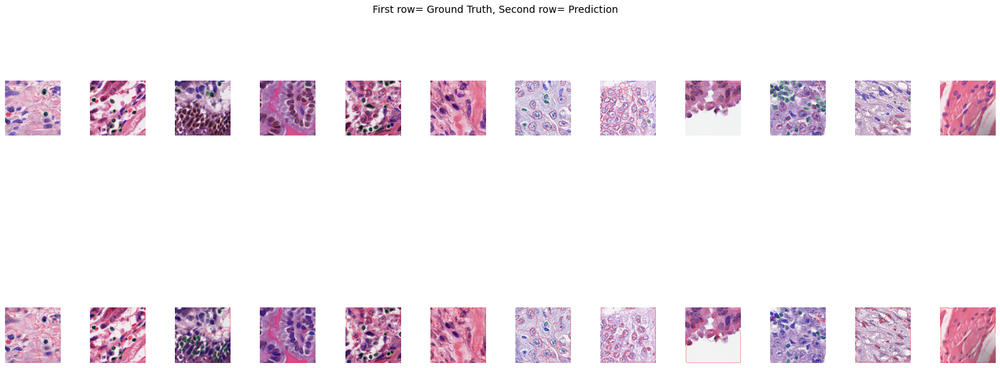

=========================== EPOCH: 13 ===========================
TRAIN LOSS:
train loss=0.265: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.308: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


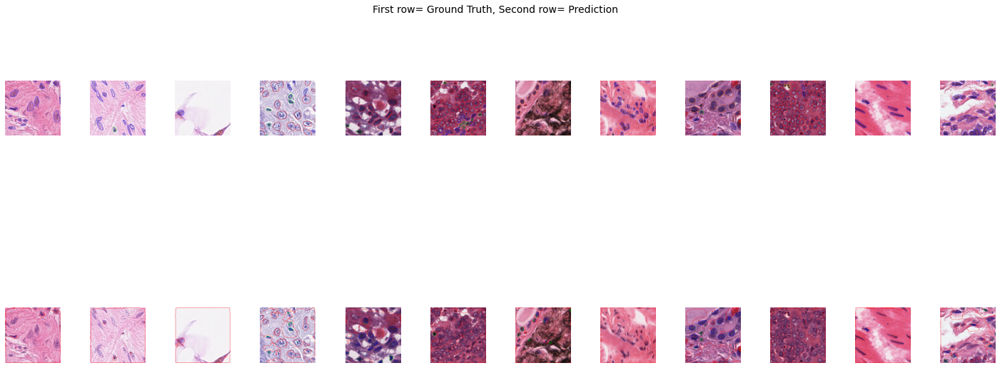

=========================== EPOCH: 14 ===========================
TRAIN LOSS:
train loss=0.260: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.301: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


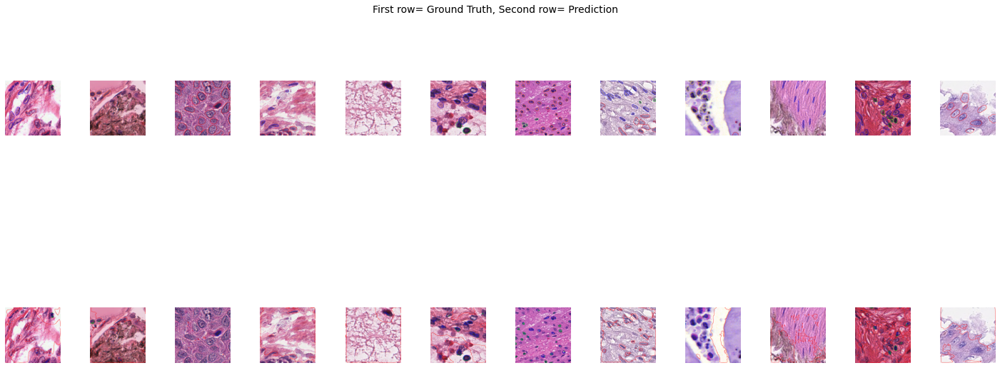

=========================== EPOCH: 15 ===========================
TRAIN LOSS:
train loss=0.262: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.321: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


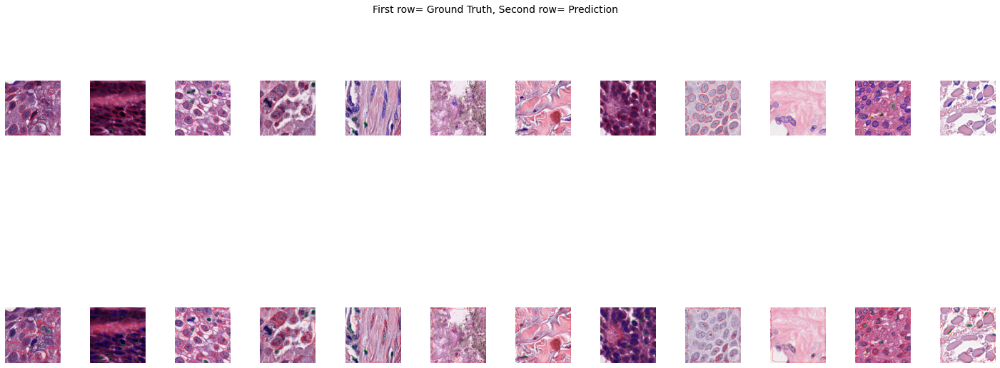

=========================== EPOCH: 16 ===========================
TRAIN LOSS:
train loss=0.253: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.295: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


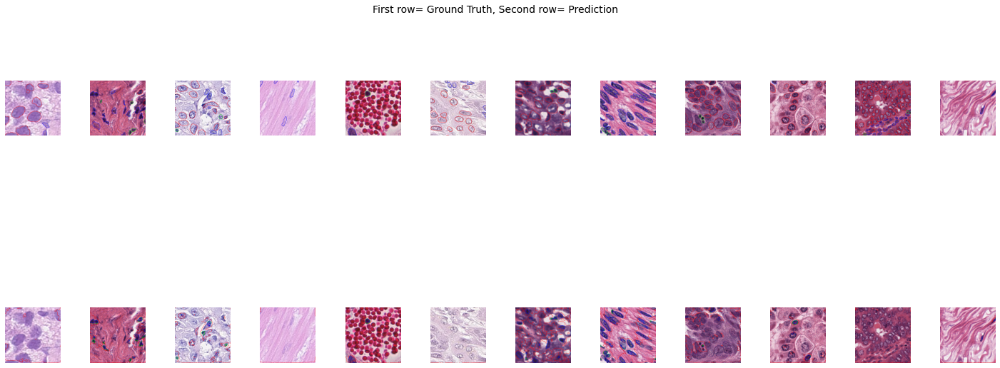

=========================== EPOCH: 17 ===========================
TRAIN LOSS:
train loss=0.248: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.305: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


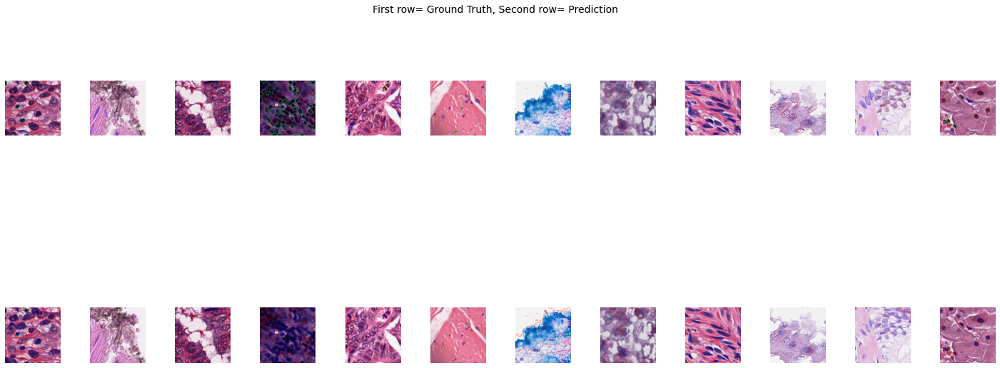

=========================== EPOCH: 18 ===========================
TRAIN LOSS:
train loss=0.248: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.278: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


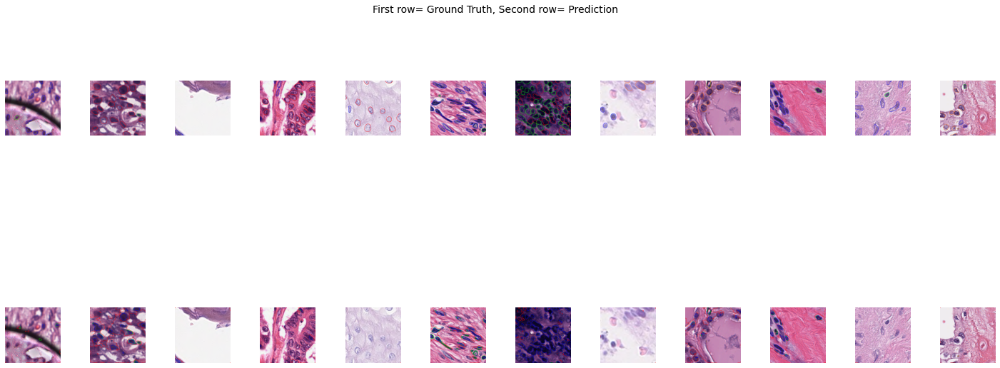

=========================== EPOCH: 19 ===========================
TRAIN LOSS:
train loss=0.241: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.277: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


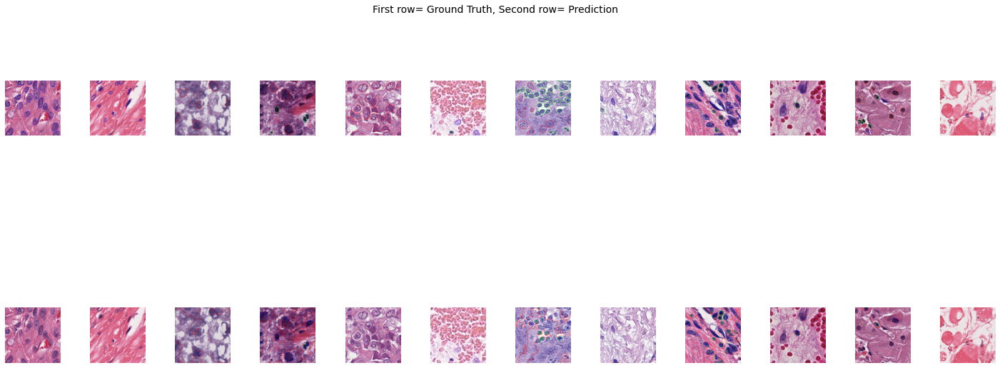

=========================== EPOCH: 20 ===========================
TRAIN LOSS:
train loss=0.240: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.293: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


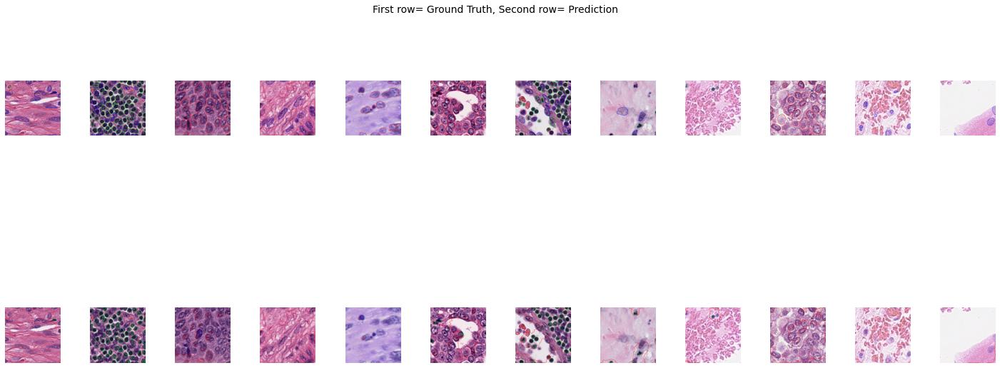

=========================== EPOCH: 21 ===========================
TRAIN LOSS:
train loss=0.234: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.288: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


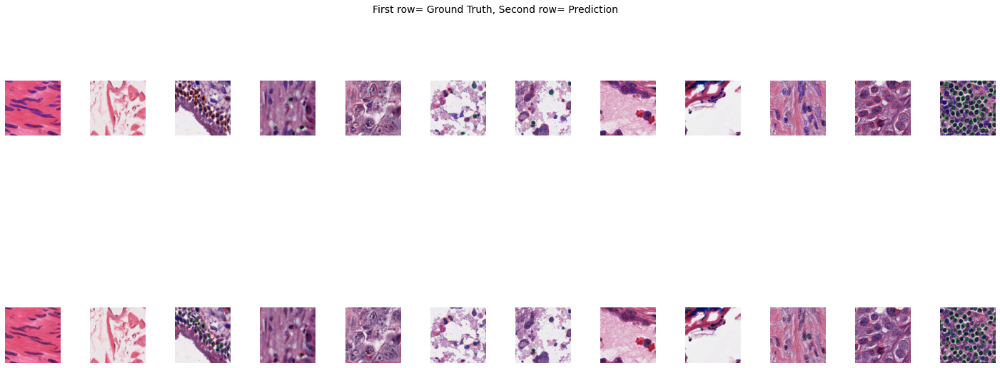

=========================== EPOCH: 22 ===========================
TRAIN LOSS:
train loss=0.237: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.280: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


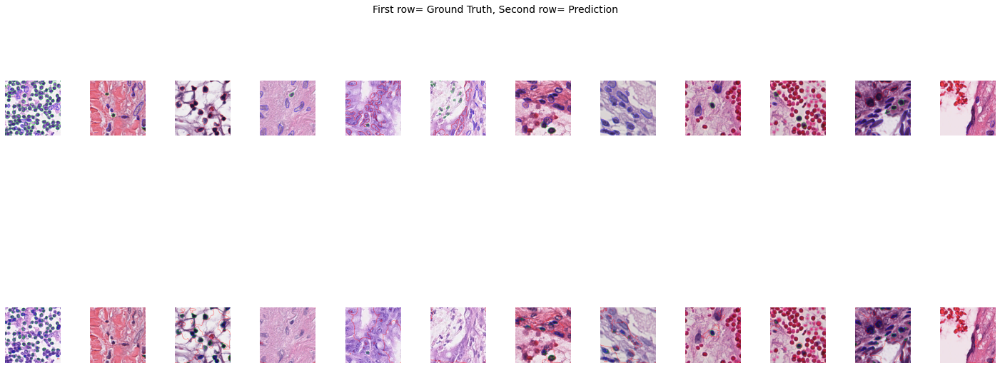

=========================== EPOCH: 23 ===========================
TRAIN LOSS:
train loss=0.231: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.261: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


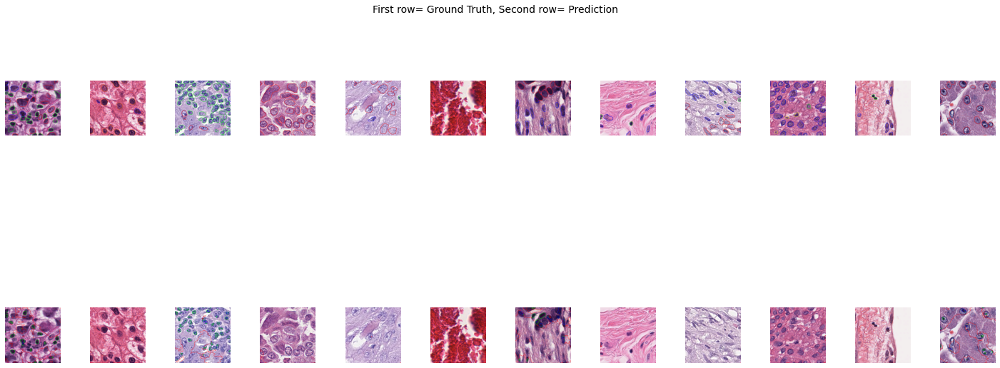

=========================== EPOCH: 24 ===========================
TRAIN LOSS:
train loss=0.229: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.269: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


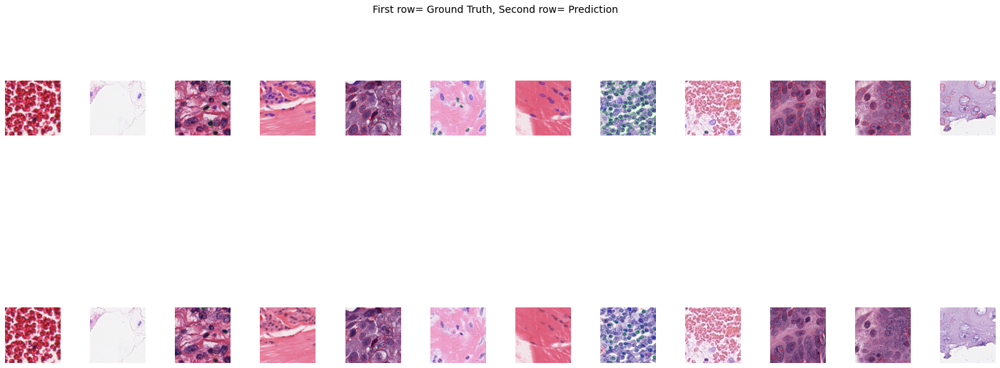

=========================== EPOCH: 25 ===========================
TRAIN LOSS:
train loss=0.226: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.256: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


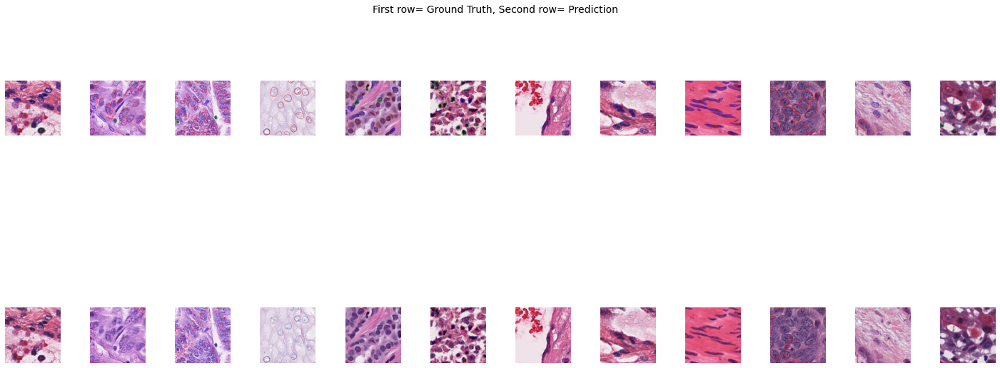

=========================== EPOCH: 26 ===========================
TRAIN LOSS:
train loss=0.223: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.258: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


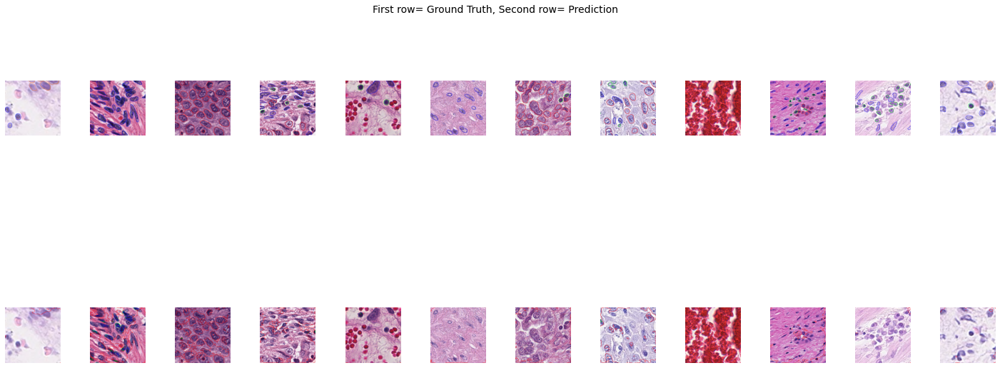

=========================== EPOCH: 27 ===========================
TRAIN LOSS:
train loss=0.220: 100%|██████████| 527/527 [07:17<00:00,  1.20it/s]
VAL LOSS:
val loss=0.245: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


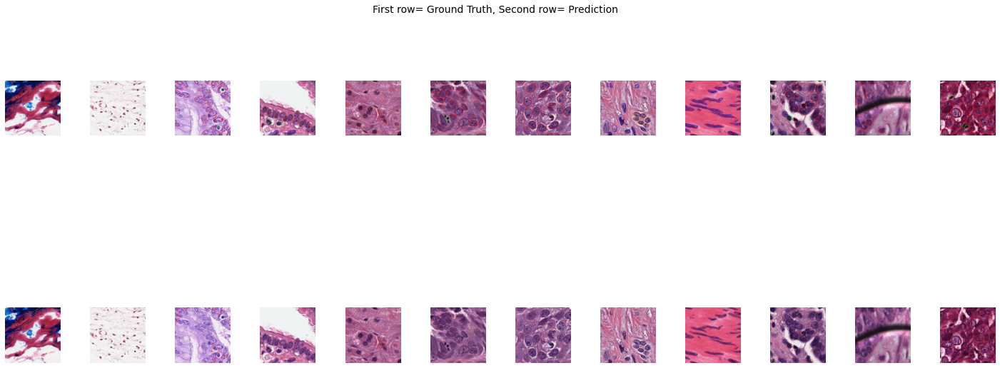

=========================== EPOCH: 28 ===========================
TRAIN LOSS:
train loss=0.220: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.244: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


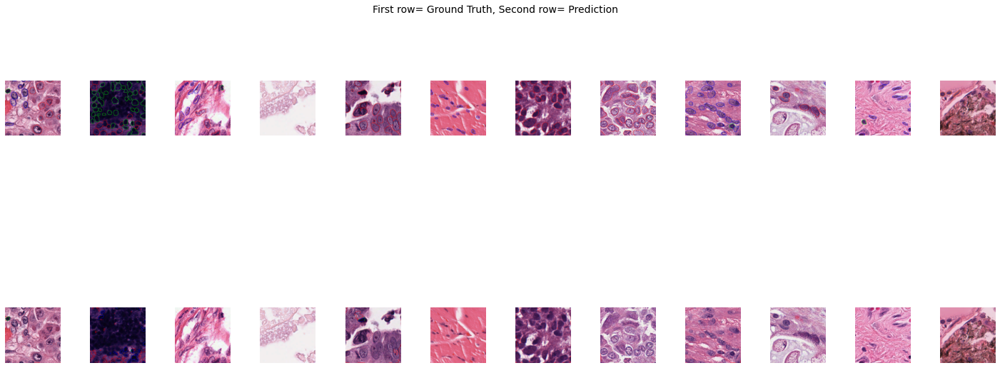

=========================== EPOCH: 29 ===========================
TRAIN LOSS:
train loss=0.217: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.238: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


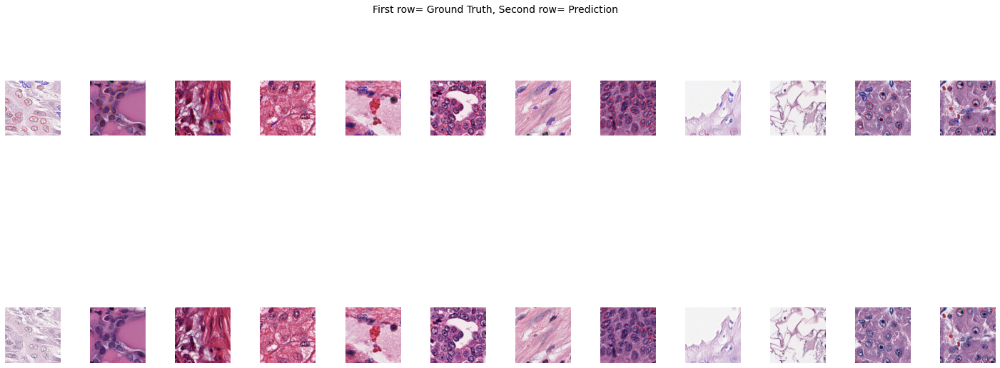

=========================== EPOCH: 30 ===========================
TRAIN LOSS:
train loss=0.217: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.251: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


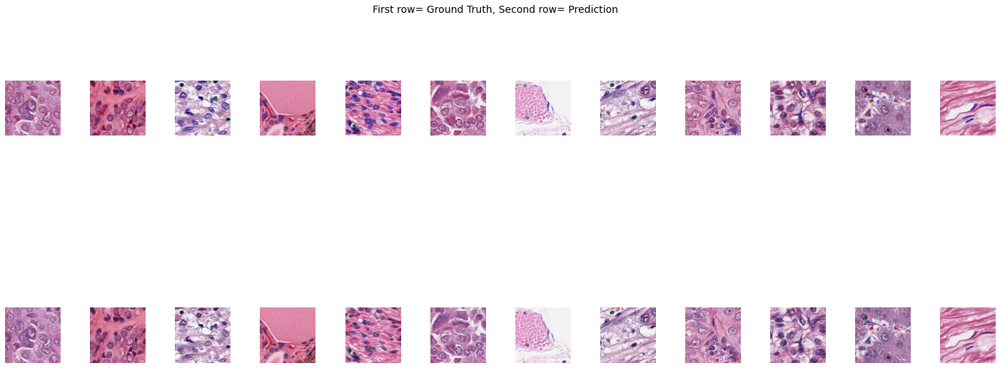

=========================== EPOCH: 31 ===========================
TRAIN LOSS:
train loss=0.214: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.241: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


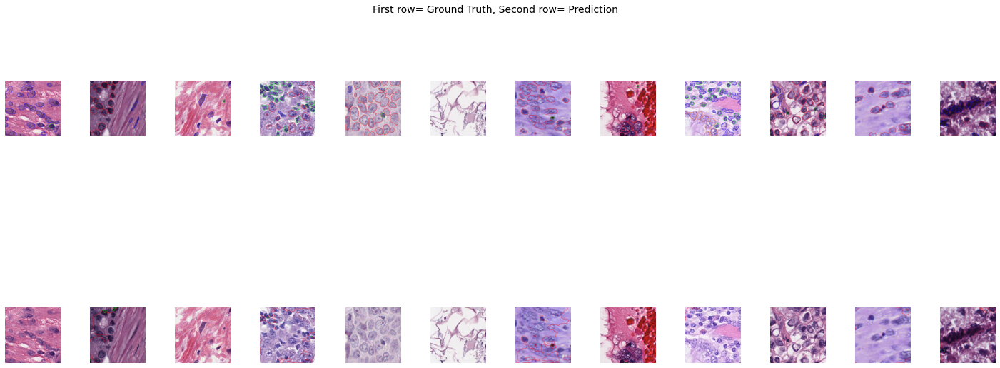

=========================== EPOCH: 32 ===========================
TRAIN LOSS:
train loss=0.212: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.252: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


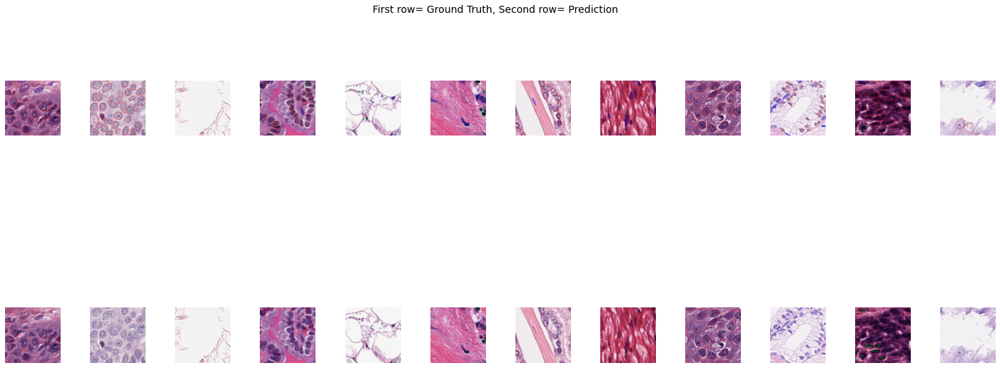

=========================== EPOCH: 33 ===========================
TRAIN LOSS:
train loss=0.211: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.236: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


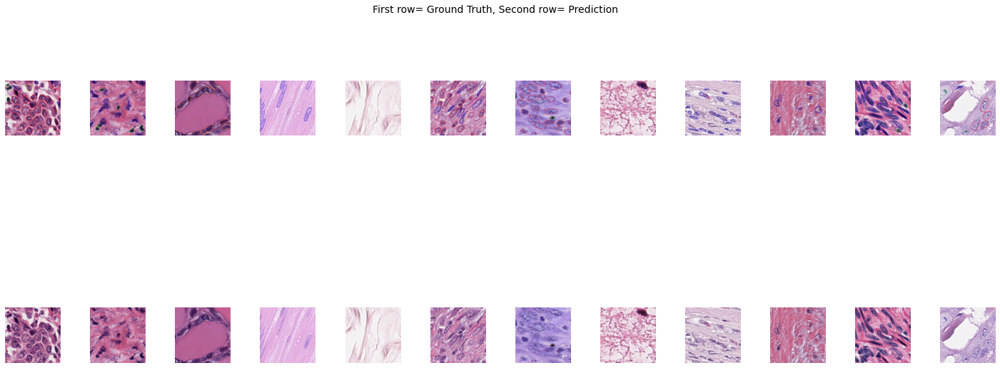

=========================== EPOCH: 34 ===========================
TRAIN LOSS:
train loss=0.210: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.256: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


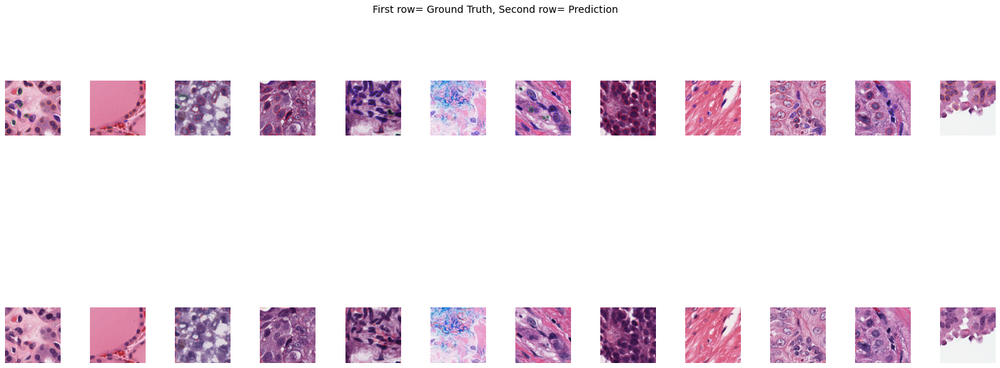

=========================== EPOCH: 35 ===========================
TRAIN LOSS:
train loss=0.208: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.236: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


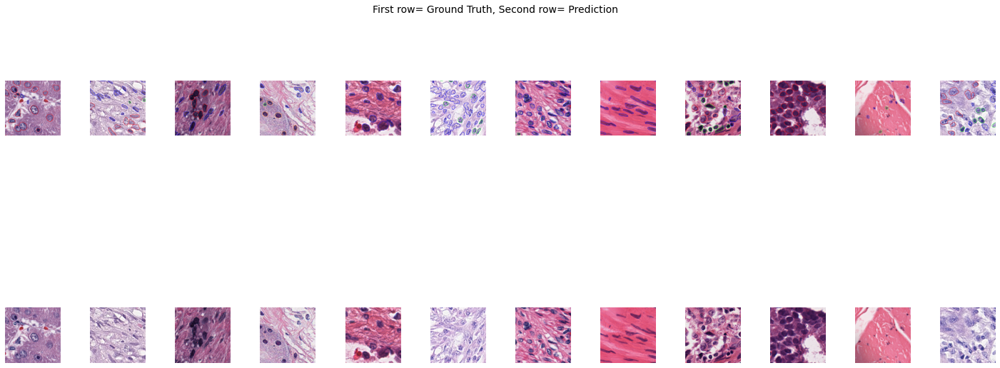

=========================== EPOCH: 36 ===========================
TRAIN LOSS:
train loss=0.206: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.226: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


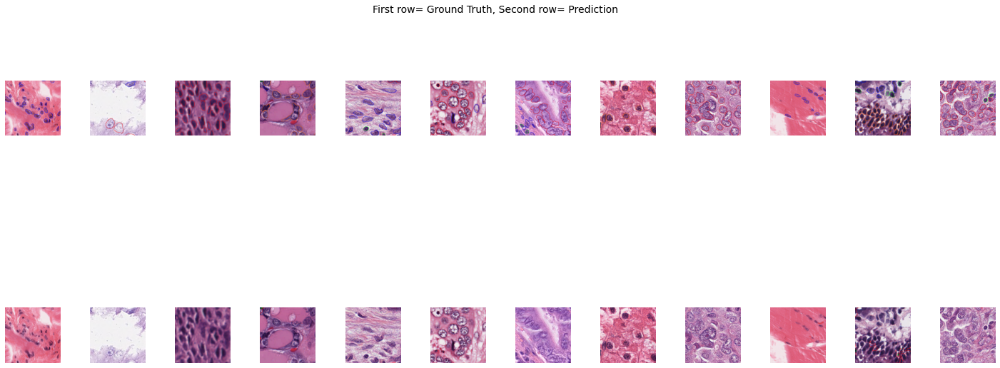

=========================== EPOCH: 37 ===========================
TRAIN LOSS:
train loss=0.205: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.229: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


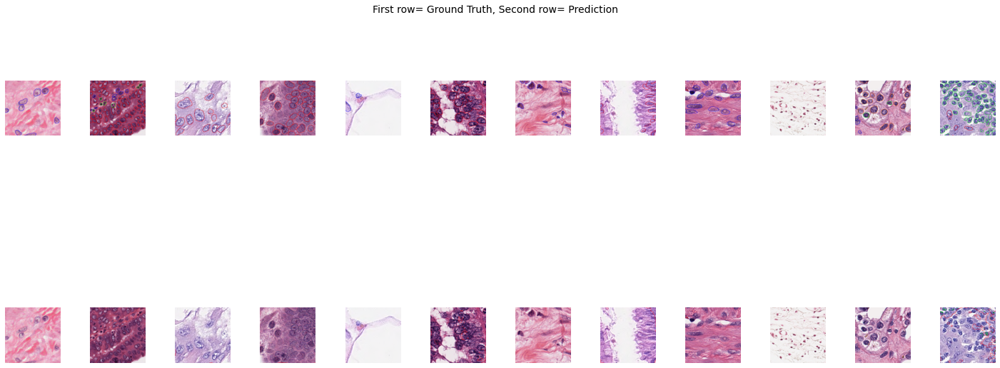

=========================== EPOCH: 38 ===========================
TRAIN LOSS:
train loss=0.206: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.231: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


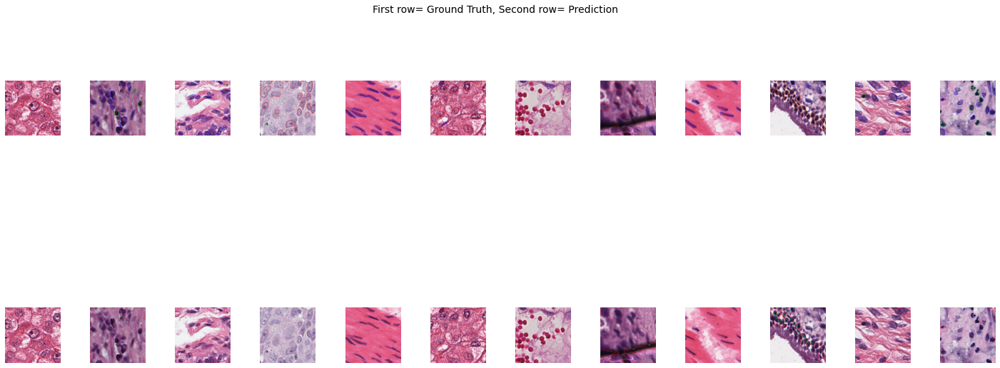

=========================== EPOCH: 39 ===========================
TRAIN LOSS:
train loss=0.202: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.238: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


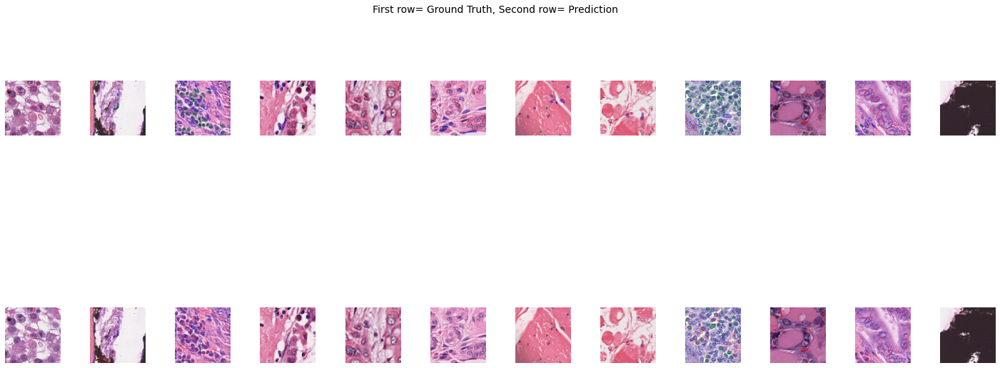

=========================== EPOCH: 40 ===========================
TRAIN LOSS:
train loss=0.202: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.221: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


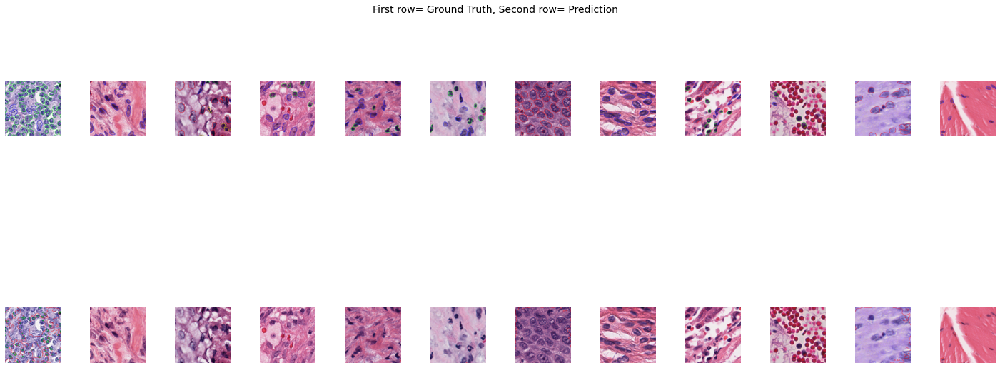

=========================== EPOCH: 41 ===========================
TRAIN LOSS:
train loss=0.200: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.221: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


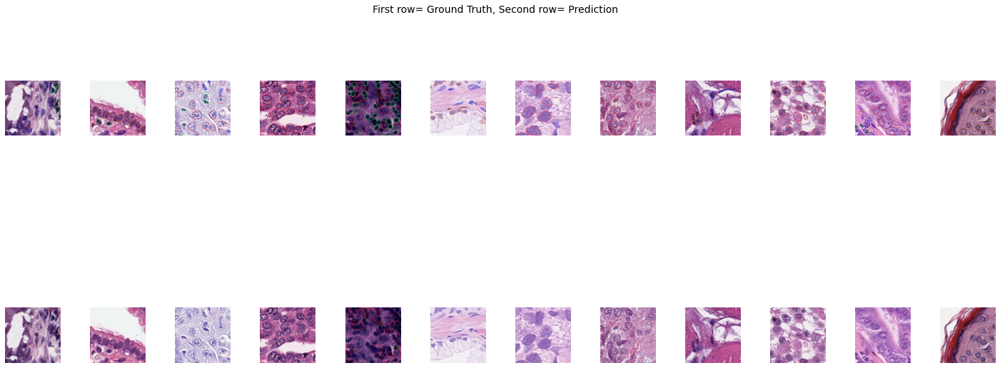

=========================== EPOCH: 42 ===========================
TRAIN LOSS:
train loss=0.199: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.222: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


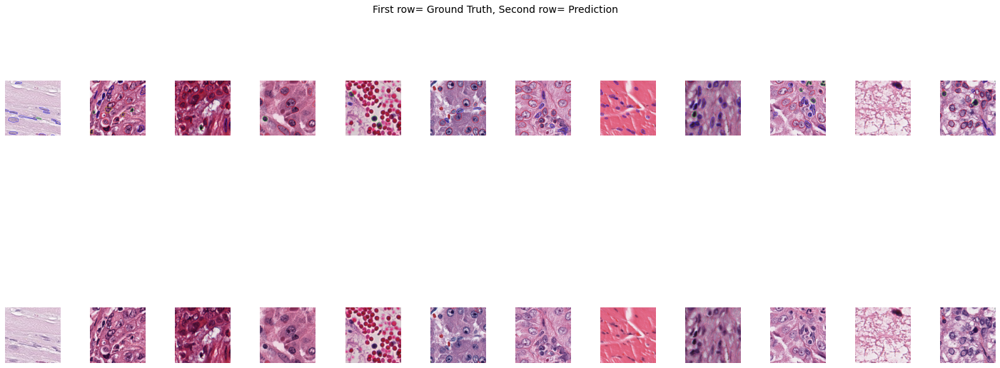

=========================== EPOCH: 43 ===========================
TRAIN LOSS:
train loss=0.198: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.208: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


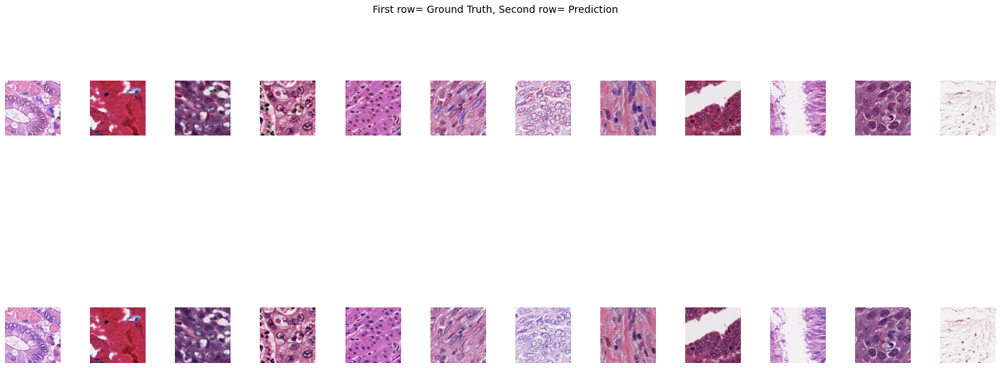

=========================== EPOCH: 44 ===========================
TRAIN LOSS:
train loss=0.196: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.213: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


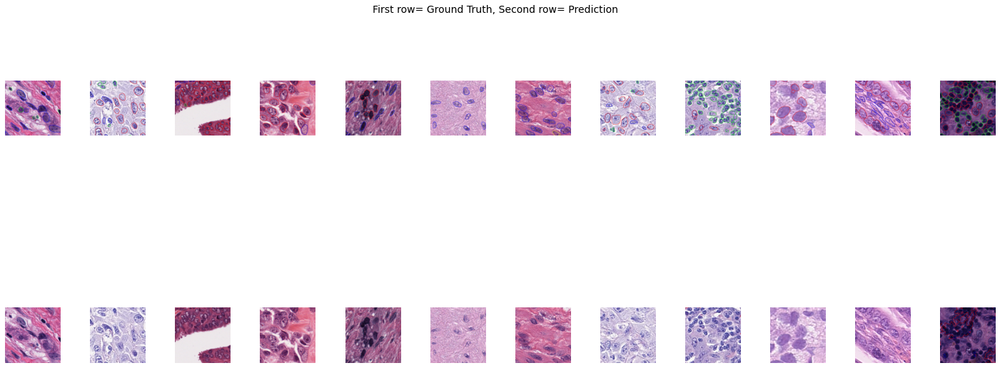

=========================== EPOCH: 45 ===========================
TRAIN LOSS:
train loss=0.195: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.213: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


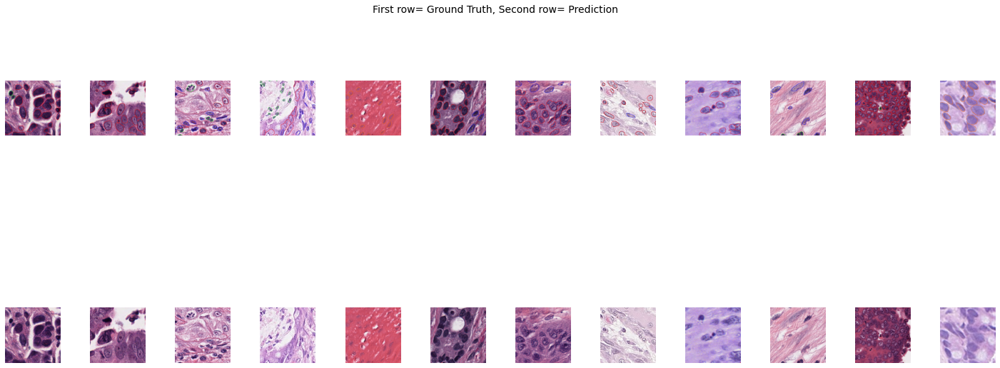

=========================== EPOCH: 46 ===========================
TRAIN LOSS:
train loss=0.194: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.216: 100%|██████████| 66/66 [00:21<00:00,  3.03it/s]


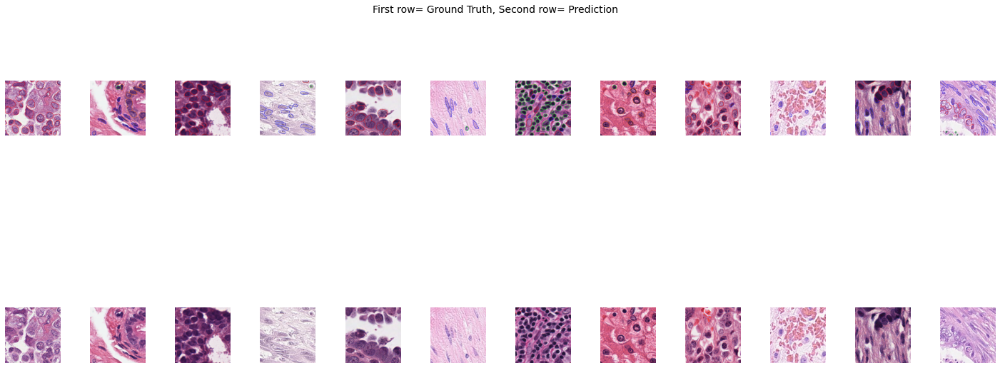

=========================== EPOCH: 47 ===========================
TRAIN LOSS:
train loss=0.192: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.206: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


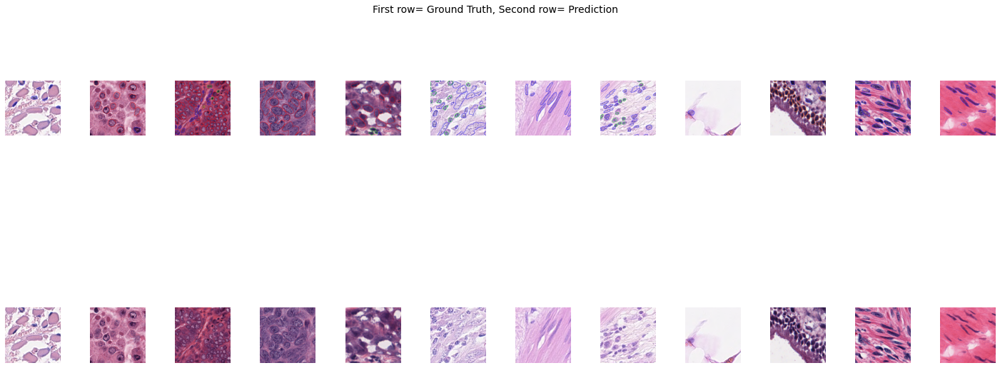

=========================== EPOCH: 48 ===========================
TRAIN LOSS:
train loss=0.193: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.207: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


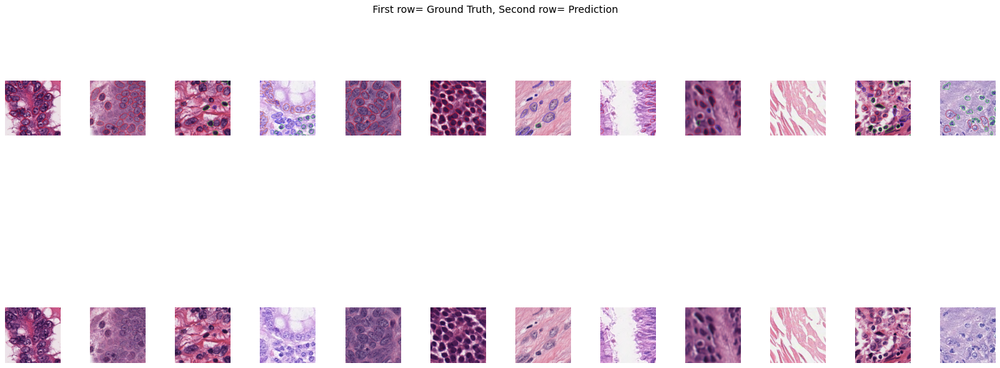

=========================== EPOCH: 49 ===========================
TRAIN LOSS:
train loss=0.192: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.214: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


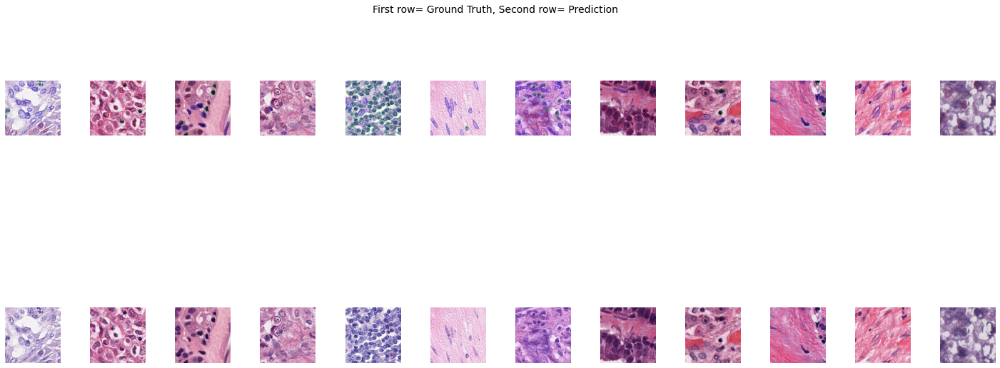

=========================== EPOCH: 50 ===========================
TRAIN LOSS:
train loss=0.191: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.202: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/util.py", line 300, in _run_finalizers
    finalizer()
  File "/usr/lib/python3.7/multiprocessing/util.py", line 224, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/usr/lib/python3.7/multiprocessing/util.py", line 133, in _remove_temp_dir
    rmtree(tempdir)
  File "/usr/lib/python3.7/shutil.py", line 498, in rmtree
    onerror(os.rmdir, path, sys.exc_info())
  File "/usr/lib/python3.7/shutil.py", line 496, in rmtree
    os.rmdir(path)
OSError: [Errno 39] Directory not empty: '/tmp/pymp-3am696ey'


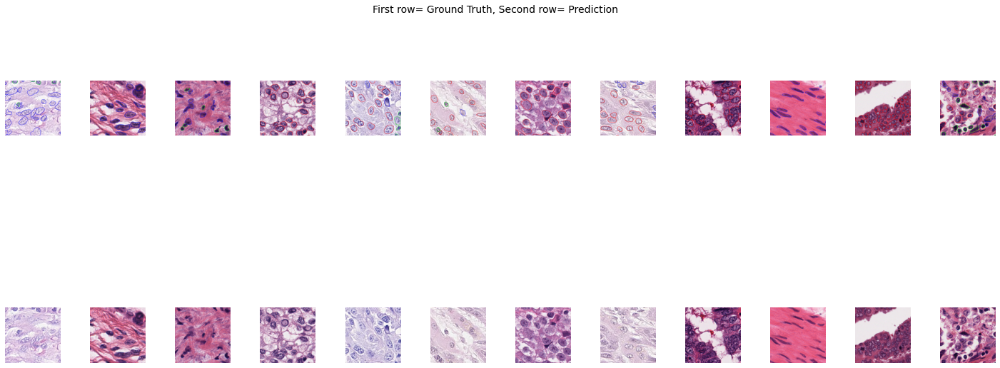

=========================== EPOCH: 51 ===========================
TRAIN LOSS:
train loss=0.189: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.197: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


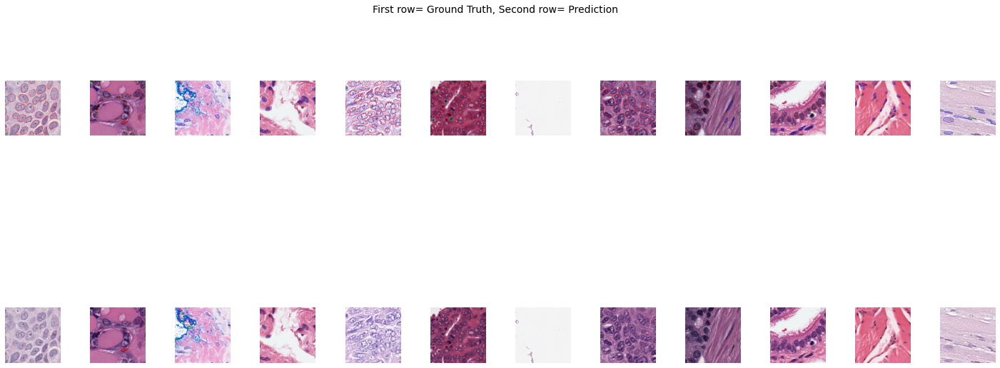

=========================== EPOCH: 52 ===========================
TRAIN LOSS:
train loss=0.189: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.203: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


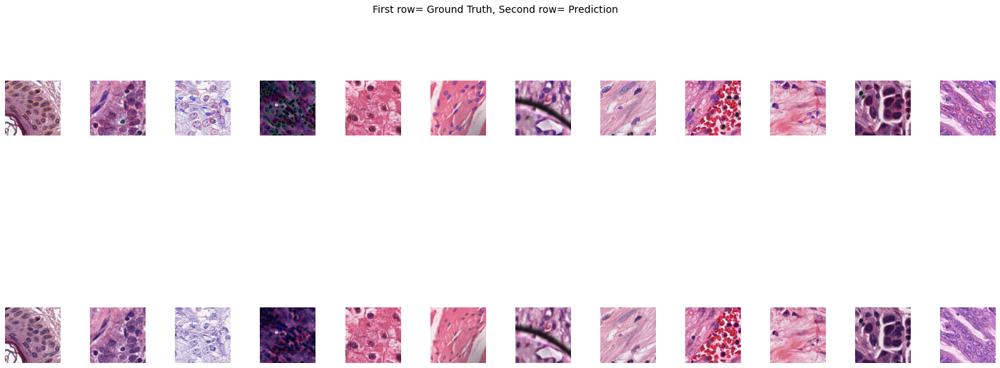

=========================== EPOCH: 53 ===========================
TRAIN LOSS:
train loss=0.189: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.206: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


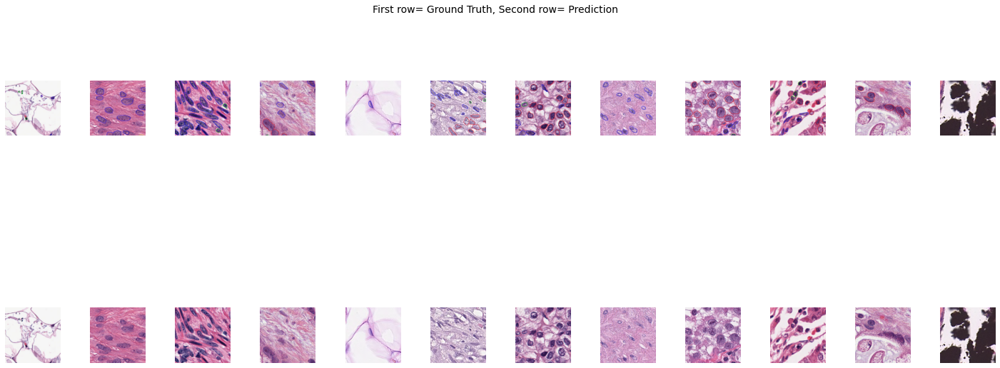

=========================== EPOCH: 54 ===========================
TRAIN LOSS:
train loss=0.188: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.206: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


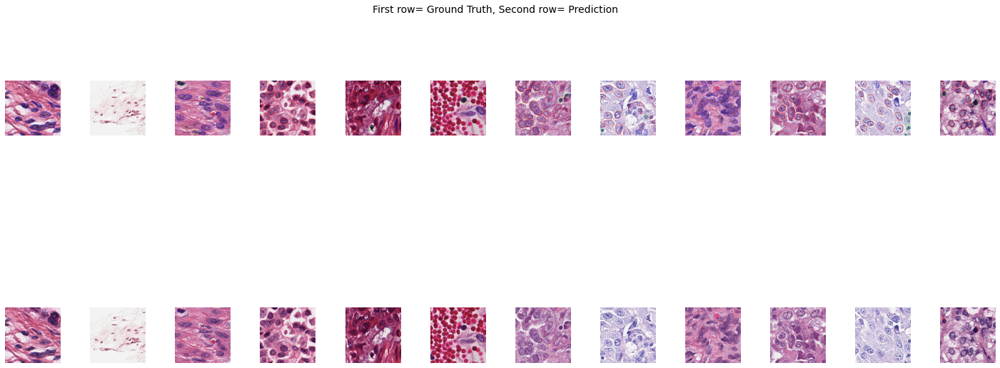

=========================== EPOCH: 55 ===========================
TRAIN LOSS:
train loss=0.187: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.202: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


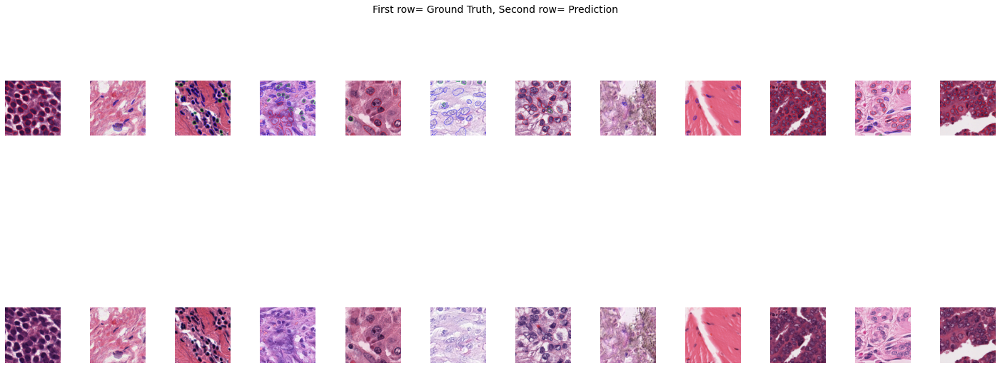

=========================== EPOCH: 56 ===========================
TRAIN LOSS:
train loss=0.186: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.197: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


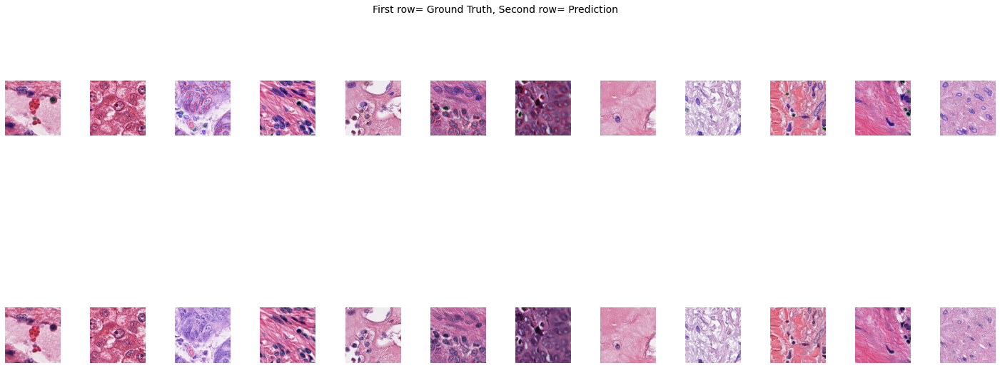

=========================== EPOCH: 57 ===========================
TRAIN LOSS:
train loss=0.186: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.201: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


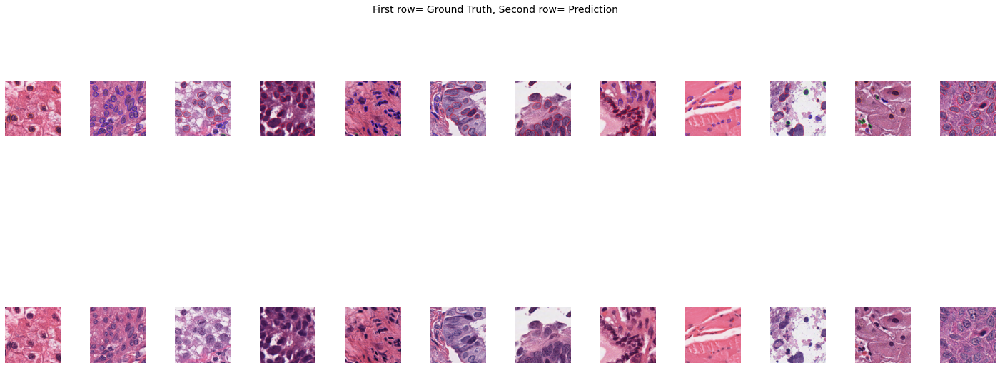

=========================== EPOCH: 58 ===========================
TRAIN LOSS:
train loss=0.186: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.198: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


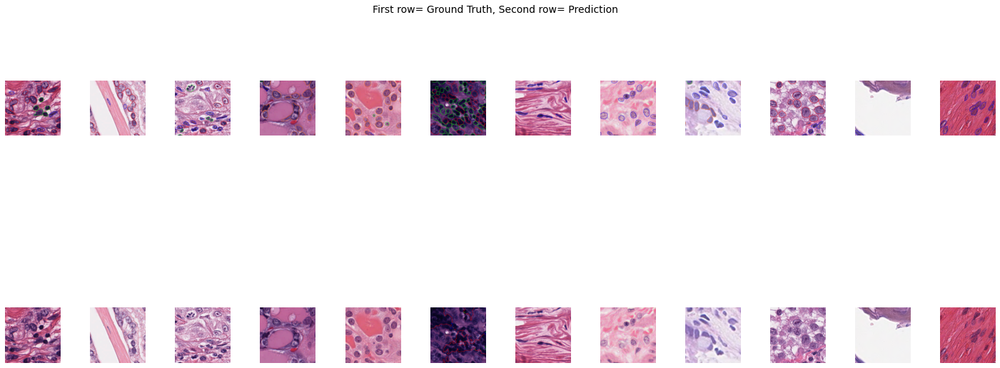

=========================== EPOCH: 59 ===========================
TRAIN LOSS:
train loss=0.185: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.199: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


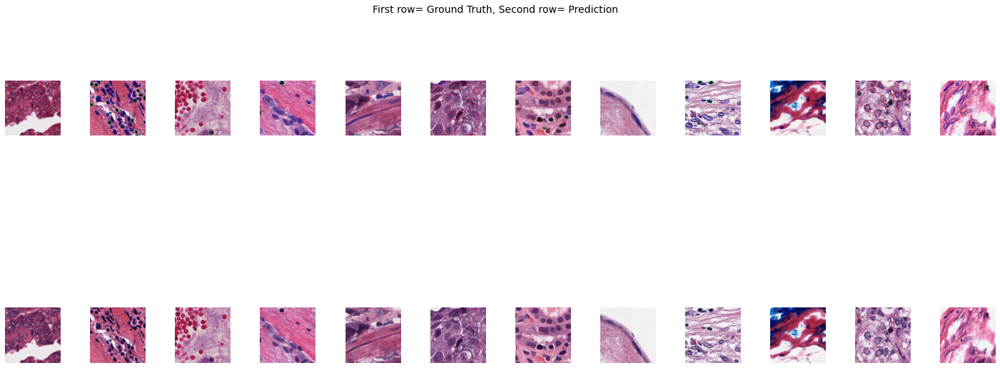

=========================== EPOCH: 60 ===========================
TRAIN LOSS:
train loss=0.185: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.199: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


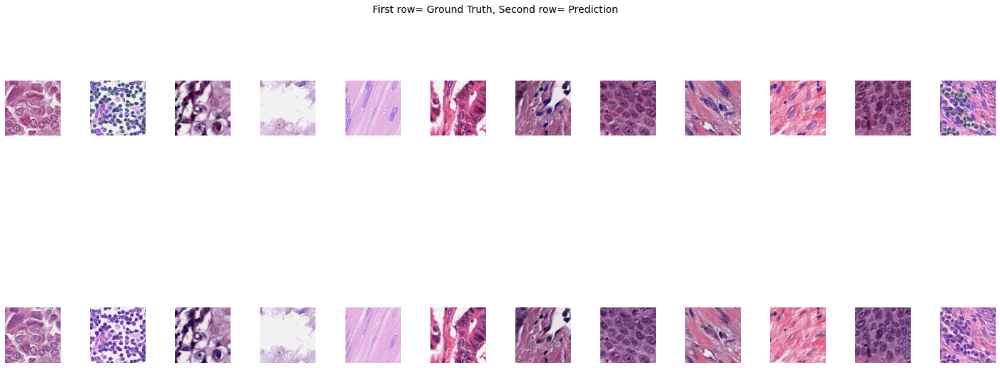

=========================== EPOCH: 61 ===========================
TRAIN LOSS:
train loss=0.185: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.199: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


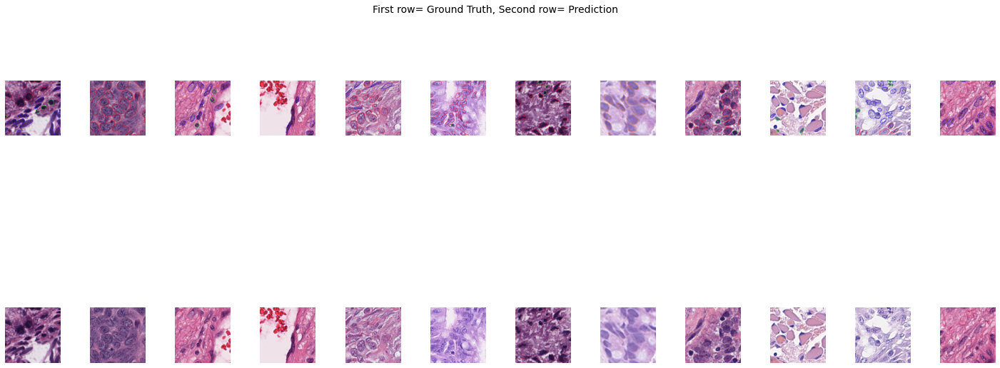

=========================== EPOCH: 62 ===========================
TRAIN LOSS:
train loss=0.184: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.196: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


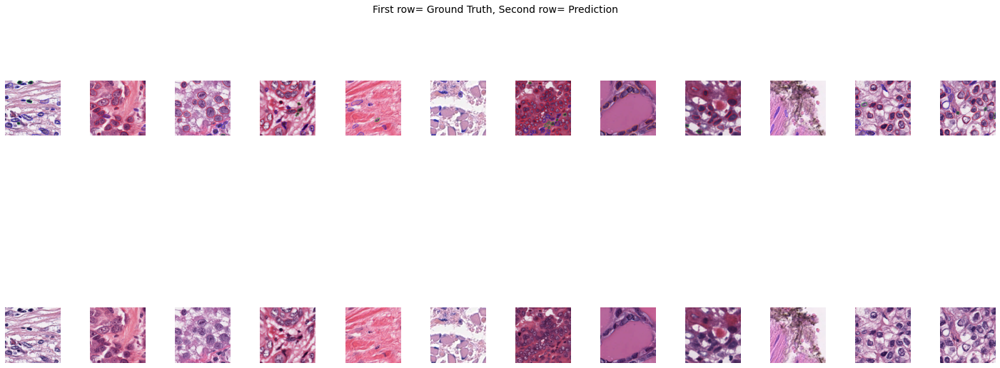

=========================== EPOCH: 63 ===========================
TRAIN LOSS:
train loss=0.184: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.194: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


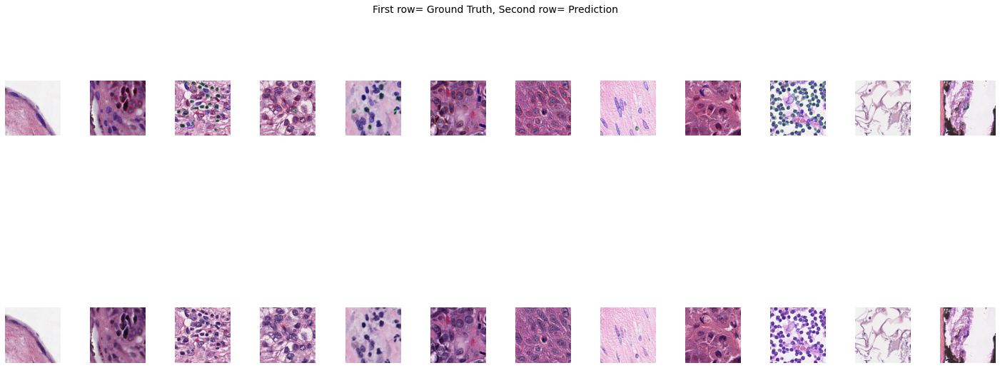

=========================== EPOCH: 64 ===========================
TRAIN LOSS:
train loss=0.184: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.198: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


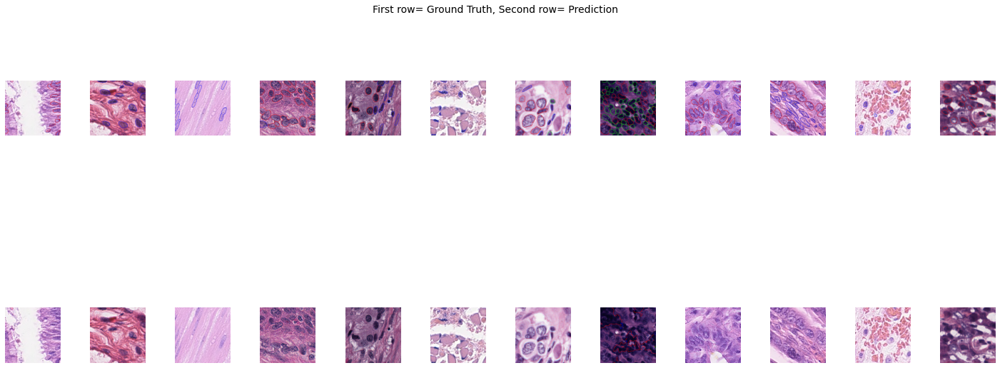

=========================== EPOCH: 65 ===========================
TRAIN LOSS:
train loss=0.183: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.207: 100%|██████████| 66/66 [00:22<00:00,  3.00it/s]


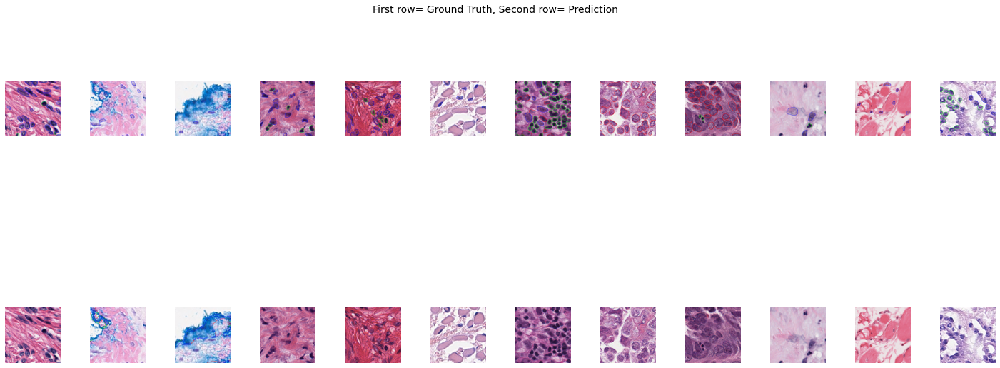

=========================== EPOCH: 66 ===========================
TRAIN LOSS:
train loss=0.182: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.205: 100%|██████████| 66/66 [00:21<00:00,  3.01it/s]


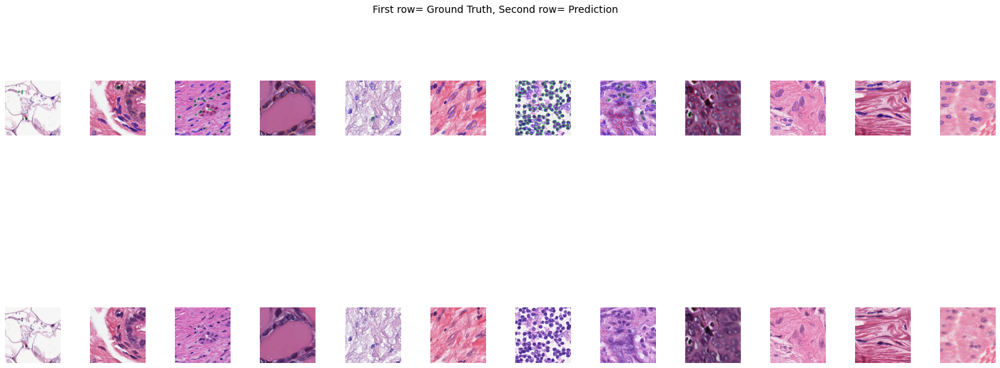

=========================== EPOCH: 67 ===========================
TRAIN LOSS:
train loss=0.183: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.197: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


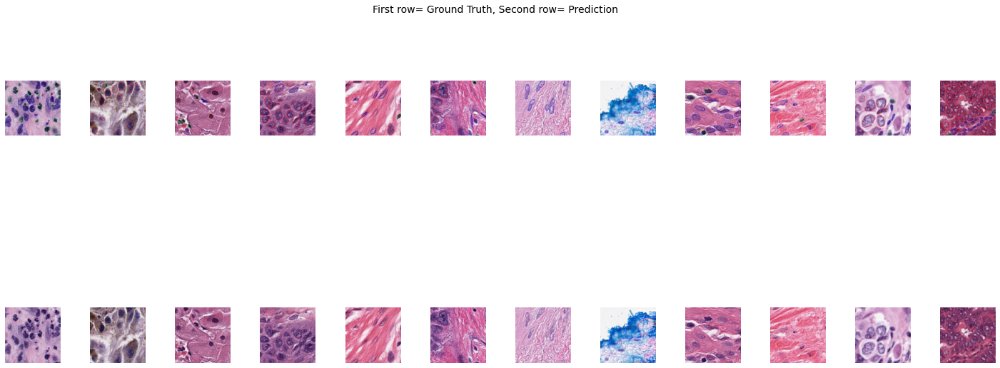

=========================== EPOCH: 68 ===========================
TRAIN LOSS:
train loss=0.182: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.196: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


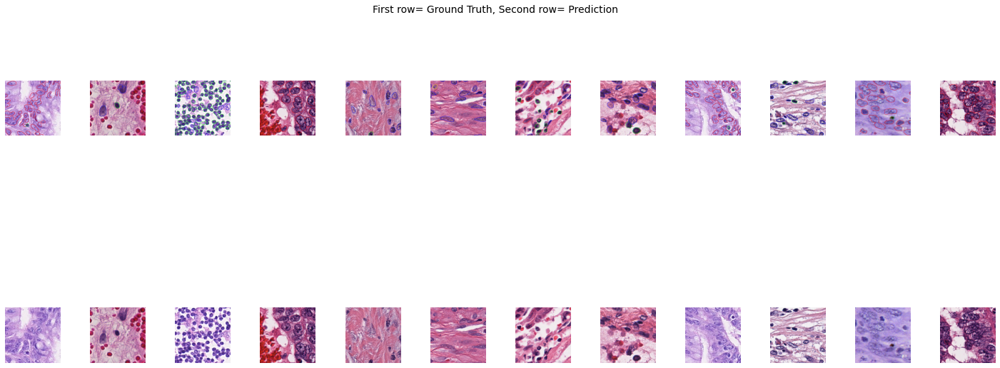

=========================== EPOCH: 69 ===========================
TRAIN LOSS:
train loss=0.182: 100%|██████████| 527/527 [07:18<00:00,  1.20it/s]
VAL LOSS:
val loss=0.197: 100%|██████████| 66/66 [00:21<00:00,  3.02it/s]


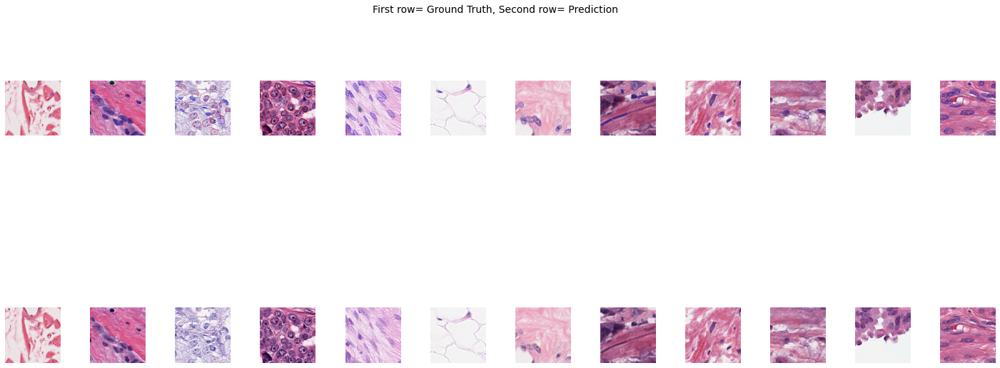

=========================== EPOCH: 70 ===========================
TRAIN LOSS:
train loss=0.213:  25%|██▌       | 132/527 [01:50<05:29,  1.20it/s]


KeyboardInterrupt: ignored

In [ ]:
from torchsummary import summary
import torch
import torch.nn as nn
# creating model
model = Unet(scale=1).to(device)
summary(model, (3,256,256))

# # visualization sample              # save every RAM we have!
# image, masks = iter(training_loader_1).next()
# vis_sample(image[0,...], masks[0,...])

# config training
epochs = 500
loss_function = CE
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001, betas=(0.9,0.999), eps =1e-08)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, 2, gamma=0.9)


PATH = root_path + "model_Unet.pt"
min_val_loss = np.inf
# training
for i in range (1,epochs):
 print("=========================== EPOCH: {} ===========================".format(str(i)))
 print("TRAIN LOSS:")
 #train_epoch(training_loader=training_loader, model=model, optimizer=optimizer, loss_function=loss_function, overfit=True, images=image_batch, masks=masks_batch, vis=vis)
 train_epoch(training_loader=training_loader, model=model, optimizer=optimizer, loss_function=loss_function)
 print("VAL LOSS:")
 val_loss = eval_loss_epoch(training_loader=validation_loader, model=model, loss_function=loss_function)
 scheduler.step()
 if val_loss < min_val_loss:
   torch.save(model, PATH)
   min_val_loss = val_loss
 visualize_segmented_ground_truth(test_loader, model, "unet")
 #vis_predictions()

# loading model
model = UNet().to(device)
model = torch.load(PATH)

# visualizing predictions
vis_predictions()

print("END")

# **Visualizing Predictions & Evaluating Result**


IOU =0.467 ; DICE =0.533: 100%|██████████| 66/66 [00:23<00:00,  2.80it/s]


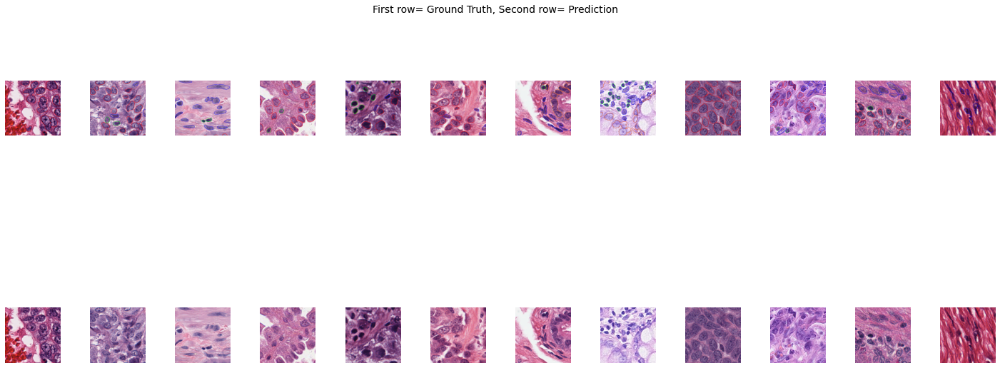




								 SAMPLE: 0


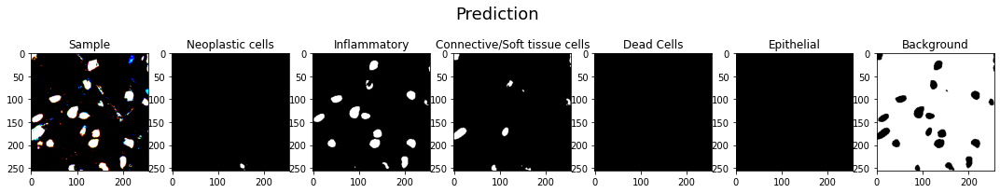

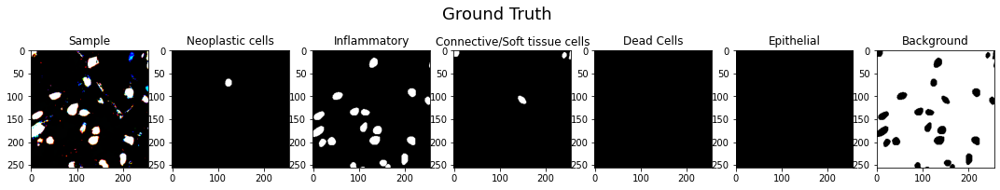




								 SAMPLE: 1


IndexError: ignored

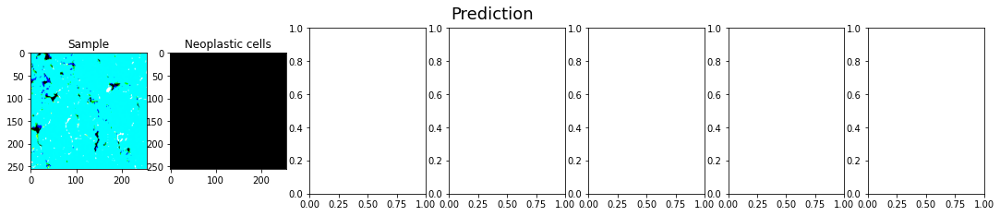

In [ ]:
#saving model
# PATH = root_path + "/model_UNet.pt"
# torch.save(model, PATH)

model = Unet().to(device)
PATH = root_path + "model_Unet.pt"
model = torch.load(PATH)

eval_model(model,test_loader)
visualize_segmented_ground_truth(test_loader, model, "unet")
vis_predictions()

In [ ]:
torch.cuda.empty_cache()
